In [1]:
from sklearn.metrics import accuracy_score
import pandas as pd
from copy import deepcopy
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import numpy as np
import plotly.express as px

In [2]:

data_train_preds = pd.read_csv("Buchwald_Hartwig_l1_loss_sm_bs_f0_train_preds.csv")
data_train_preds['label'] = data_train_preds['label'].astype(int)
data_train_preds.head()

,rsmiles,psmiles,YIELD,predicted,label,reaction class,num not zero atoms
0,[CH3:8][c:9]1[cH:10][cH:11][c:12]([NH2:13])[cH...,[c:2]1([NH:13][c:12]2[cH:11][cH:10][c:9]([CH3:...,0.692304,1,0,0,3
1,[CH3:8][c:9]1[cH:10][cH:11][c:12]([NH2:13])[cH...,[c:2]1([NH:13][c:12]2[cH:11][cH:10][c:9]([CH3:...,0.110176,0,0,0,5
2,[CH3:10][c:11]1[cH:12][cH:13][c:14]([NH2:15])[...,[CH3:1][CH2:2][c:3]1[cH:4][cH:5][c:6]([NH:15][...,0.088796,0,0,0,6
3,[CH3:12][c:13]1[cH:14][cH:15][c:16]([NH2:17])[...,[F:1][C:2]([F:3])([F:4])[c:5]1[cH:6][cH:7][c:8...,0.204815,0,0,0,6
4,[CH3:10][c:11]1[cH:12][cH:13][c:14]([NH2:15])[...,[CH3:1][O:2][c:3]1[cH:4][cH:5][c:6]([NH:15][c:...,0.004132,0,0,0,4


In [3]:
min(data_train_preds['YIELD']), max(data_train_preds['YIELD'])

(-0.037628241875194264, 0.993451701933983)

In [15]:
representations = pd.read_csv("Buchwald_Hartwig_l1_loss_sm_bs_f0_train_representations_refactored_DMPNN.csv")
representations.head()

,rsmiles,psmiles,entry_no_0,entry_no_1,entry_no_2,entry_no_3,entry_no_4,entry_no_5,entry_no_6,entry_no_7,...,entry_no_990,entry_no_991,entry_no_992,entry_no_993,entry_no_994,entry_no_995,entry_no_996,entry_no_997,entry_no_998,entry_no_999
0,[CH3:8][c:9]1[cH:10][cH:11][c:12]([NH2:13])[cH...,[c:2]1([NH:13][c:12]2[cH:11][cH:10][c:9]([CH3:...,0.007595,-0.047608,-0.041285,-0.011688,0.095124,-0.019146,-0.016997,0.006371,...,0.008654,-0.030782,-0.004315,-0.053521,0.042222,0.740902,-0.011726,0.010058,-0.006266,-0.070079
1,[CH3:8][c:9]1[cH:10][cH:11][c:12]([NH2:13])[cH...,[c:2]1([NH:13][c:12]2[cH:11][cH:10][c:9]([CH3:...,-0.051758,0.083115,-0.047495,-0.010799,0.046876,-0.021161,-0.035895,-0.037711,...,-0.039201,-0.028654,-0.012864,-0.041570,-0.031745,0.565420,-0.024698,-0.035431,-0.025849,-0.114967
2,[CH3:10][c:11]1[cH:12][cH:13][c:14]([NH2:15])[...,[CH3:1][CH2:2][c:3]1[cH:4][cH:5][c:6]([NH:15][...,0.003125,0.055470,0.051961,-0.013111,0.017174,0.110486,-0.015062,-0.017598,...,-0.004449,0.005130,-0.012914,-0.026146,-0.019348,-0.082050,0.023248,-0.013801,-0.014240,0.031314
3,[CH3:12][c:13]1[cH:14][cH:15][c:16]([NH2:17])[...,[F:1][C:2]([F:3])([F:4])[c:5]1[cH:6][cH:7][c:8...,0.198198,-0.011674,0.042044,-0.004297,0.002283,-0.030450,0.173286,0.245679,...,0.473943,-0.008211,-0.006285,-0.023727,0.018002,-0.050509,0.057645,0.362226,0.083423,-0.045300
4,[CH3:10][c:11]1[cH:12][cH:13][c:14]([NH2:15])[...,[CH3:1][O:2][c:3]1[cH:4][cH:5][c:6]([NH:15][c:...,0.901816,-0.021676,0.009703,0.422372,-0.034368,-0.022096,0.404095,0.745034,...,0.934890,-0.014587,0.023261,-0.048194,0.057612,-0.049269,0.030518,0.436282,0.043759,-0.012357


In [16]:
representations_copy = deepcopy(representations)
representations_copy.head()

,rsmiles,psmiles,entry_no_0,entry_no_1,entry_no_2,entry_no_3,entry_no_4,entry_no_5,entry_no_6,entry_no_7,...,entry_no_990,entry_no_991,entry_no_992,entry_no_993,entry_no_994,entry_no_995,entry_no_996,entry_no_997,entry_no_998,entry_no_999
0,[CH3:8][c:9]1[cH:10][cH:11][c:12]([NH2:13])[cH...,[c:2]1([NH:13][c:12]2[cH:11][cH:10][c:9]([CH3:...,0.007595,-0.047608,-0.041285,-0.011688,0.095124,-0.019146,-0.016997,0.006371,...,0.008654,-0.030782,-0.004315,-0.053521,0.042222,0.740902,-0.011726,0.010058,-0.006266,-0.070079
1,[CH3:8][c:9]1[cH:10][cH:11][c:12]([NH2:13])[cH...,[c:2]1([NH:13][c:12]2[cH:11][cH:10][c:9]([CH3:...,-0.051758,0.083115,-0.047495,-0.010799,0.046876,-0.021161,-0.035895,-0.037711,...,-0.039201,-0.028654,-0.012864,-0.041570,-0.031745,0.565420,-0.024698,-0.035431,-0.025849,-0.114967
2,[CH3:10][c:11]1[cH:12][cH:13][c:14]([NH2:15])[...,[CH3:1][CH2:2][c:3]1[cH:4][cH:5][c:6]([NH:15][...,0.003125,0.055470,0.051961,-0.013111,0.017174,0.110486,-0.015062,-0.017598,...,-0.004449,0.005130,-0.012914,-0.026146,-0.019348,-0.082050,0.023248,-0.013801,-0.014240,0.031314
3,[CH3:12][c:13]1[cH:14][cH:15][c:16]([NH2:17])[...,[F:1][C:2]([F:3])([F:4])[c:5]1[cH:6][cH:7][c:8...,0.198198,-0.011674,0.042044,-0.004297,0.002283,-0.030450,0.173286,0.245679,...,0.473943,-0.008211,-0.006285,-0.023727,0.018002,-0.050509,0.057645,0.362226,0.083423,-0.045300
4,[CH3:10][c:11]1[cH:12][cH:13][c:14]([NH2:15])[...,[CH3:1][O:2][c:3]1[cH:4][cH:5][c:6]([NH:15][c:...,0.901816,-0.021676,0.009703,0.422372,-0.034368,-0.022096,0.404095,0.745034,...,0.934890,-0.014587,0.023261,-0.048194,0.057612,-0.049269,0.030518,0.436282,0.043759,-0.012357


In [17]:
entries_names = representations_copy.iloc[:,2:].columns

for column in entries_names:
    representations_copy[column] = (representations_copy[column] - np.mean(representations_copy[column] ))/np.std(representations_copy[column] )

representations_copy.head()

,rsmiles,psmiles,entry_no_0,entry_no_1,entry_no_2,entry_no_3,entry_no_4,entry_no_5,entry_no_6,entry_no_7,...,entry_no_990,entry_no_991,entry_no_992,entry_no_993,entry_no_994,entry_no_995,entry_no_996,entry_no_997,entry_no_998,entry_no_999
0,[CH3:8][c:9]1[cH:10][cH:11][c:12]([NH2:13])[cH...,[c:2]1([NH:13][c:12]2[cH:11][cH:10][c:9]([CH3:...,-0.450975,-1.178262,-0.952247,-0.284938,1.391866,-0.569898,-0.565285,-0.470970,...,-0.557081,-0.968784,-0.288371,-0.722026,1.209867,2.462912,-0.490774,-0.522307,-0.429281,-0.522437
1,[CH3:8][c:9]1[cH:10][cH:11][c:12]([NH2:13])[cH...,[c:2]1([NH:13][c:12]2[cH:11][cH:10][c:9]([CH3:...,-0.651471,1.334214,-1.080366,-0.276721,0.502487,-0.595426,-0.727314,-0.659446,...,-0.711366,-0.891511,-0.737768,-0.576460,-0.921121,1.778823,-0.592649,-0.727382,-0.675093,-0.658352
2,[CH3:10][c:11]1[cH:12][cH:13][c:14]([NH2:15])[...,[CH3:1][CH2:2][c:3]1[cH:4][cH:5][c:6]([NH:15][...,-0.466074,0.802884,0.971673,-0.298075,-0.045019,1.072674,-0.548697,-0.573450,...,-0.599326,0.334758,-0.740413,-0.388605,-0.563974,-0.745236,-0.216114,-0.629869,-0.529382,-0.215435
3,[CH3:12][c:13]1[cH:14][cH:15][c:16]([NH2:17])[...,[F:1][C:2]([F:3])([F:4])[c:5]1[cH:6][cH:7][c:8...,0.192879,-0.487623,0.767054,-0.216667,-0.319493,-0.713127,1.066114,0.552203,...,0.943022,-0.149471,-0.391931,-0.359134,0.512072,-0.622279,0.054010,1.065343,0.696516,-0.447410
4,[CH3:10][c:11]1[cH:12][cH:13][c:14]([NH2:15])[...,[CH3:1][O:2][c:3]1[cH:4][cH:5][c:6]([NH:15][c:...,2.569696,-0.679860,0.099763,3.724126,-0.995103,-0.607274,3.044962,2.687224,...,2.429124,-0.380903,1.161186,-0.657141,1.653235,-0.617443,-0.159023,1.399203,0.198648,-0.347662


In [23]:
X2D = representations_copy[entries_names].to_numpy()
X_embedded2D = TSNE(n_components=2, perplexity=500).fit_transform(X2D)
X_embedded2D.shape

(2768, 2)

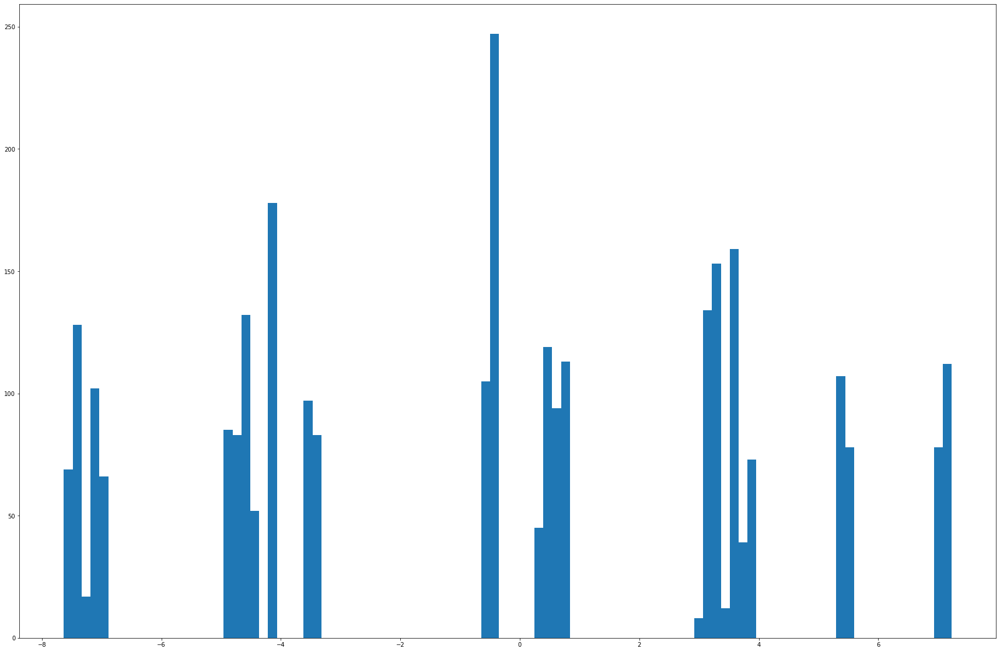

In [24]:
fig = plt.figure(figsize=(30,20))
plt.hist(X_embedded2D.T[0], bins=100)
plt.show()

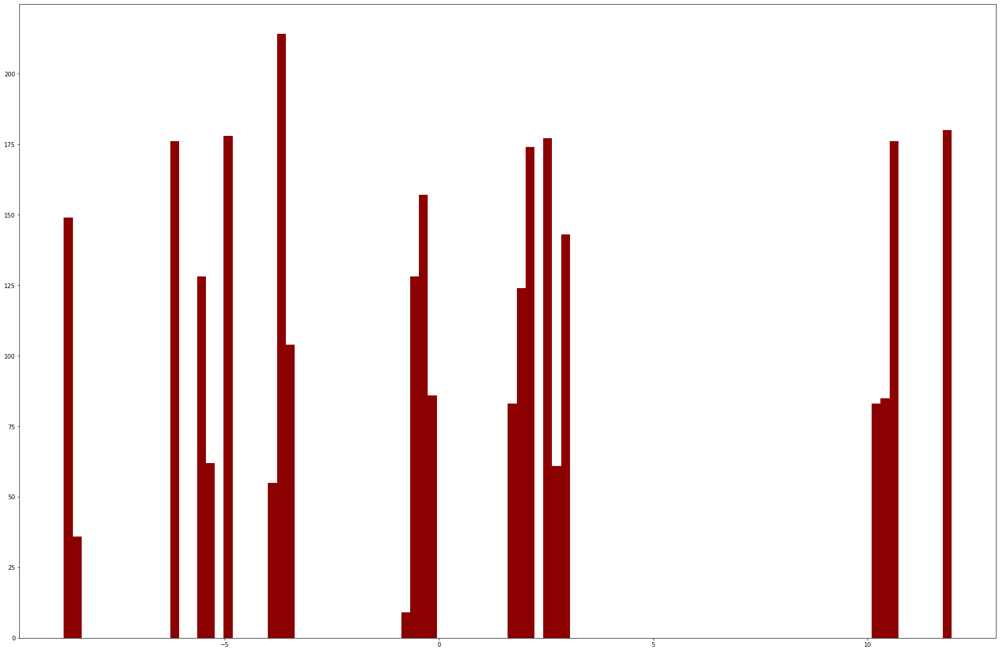

In [25]:
fig = plt.figure(figsize=(30,20))
plt.hist(X_embedded2D.T[1], color='darkred', bins=100)
plt.show()

No handles with labels found to put in legend.


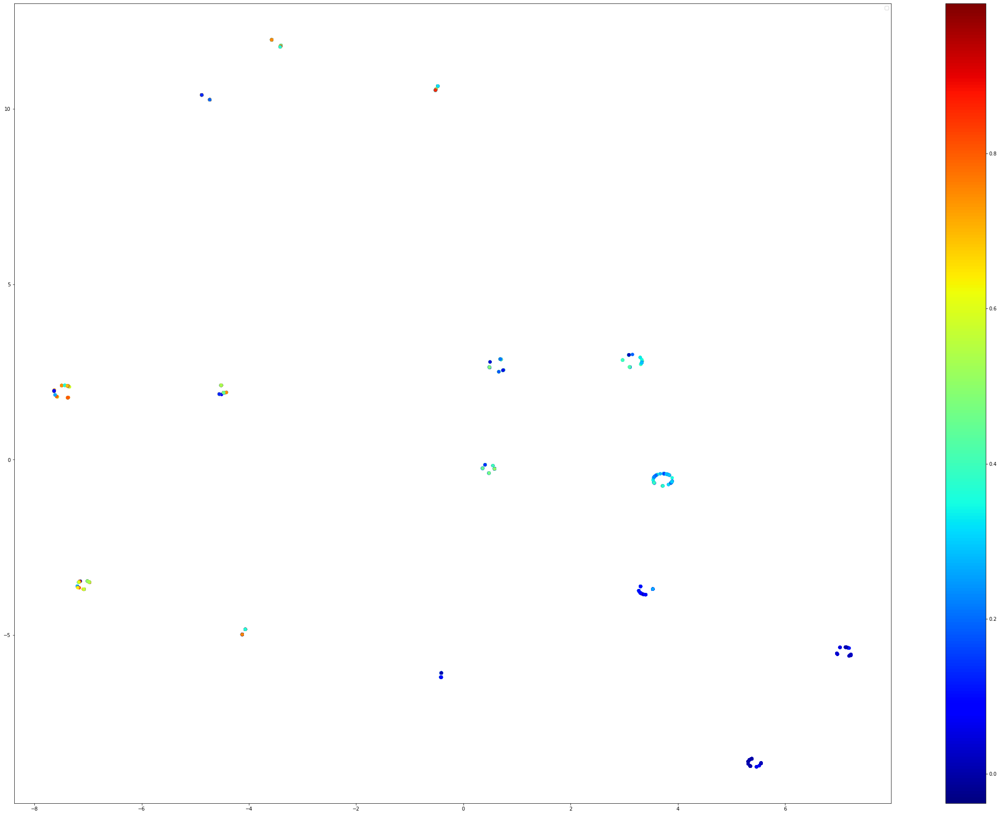

In [26]:
figure = plt.figure(figsize=(40,30))
plt.scatter(X_embedded2D.T[0], X_embedded2D.T[1], c=data_train_preds['YIELD'], cmap = 'jet')
plt.legend()
plt.colorbar()
plt.show()

# In 3D

In [19]:
X3D = representations_copy[entries_names].to_numpy()
X_embedded3D = TSNE(n_components=3, perplexity=1000).fit_transform(X3D)
X_embedded3D.shape

(2768, 3)

In [20]:
import plotly.express as px

In [21]:
def present_in_2D(data_train_preds, X_embedded2D):
    figure = plt.figure(figsize=(40,30))
    plt.scatter(X_embedded2D.T[0], X_embedded2D.T[1], c=data_train_preds['YIELD'], cmap = 'jet')
    plt.legend()
    plt.colorbar()
        
    return plt.show()

def present_in_3D(data_train_preds, X_embedded):
    df = pd.DataFrame(columns= ['x', 'y', 'z', 'predicted'])
    x, y, z, preds = [], [], [], []
    for j in range(len(X_embedded)):
        x.append(X_embedded[j][0])
        y.append(X_embedded[j][1])
        z.append(X_embedded[j][2])

        preds.append(data_train_preds['YIELD'][j])

    df['x'] = x
    df['y'] = y
    df['z'] = z
    df['predicted'] = preds

    fig = px.scatter_3d(df, x='x', y='y', z='z', color='predicted')

    return fig, df

fig1, df = present_in_3D(data_train_preds, X_embedded3D)

In [22]:
fig1.show()

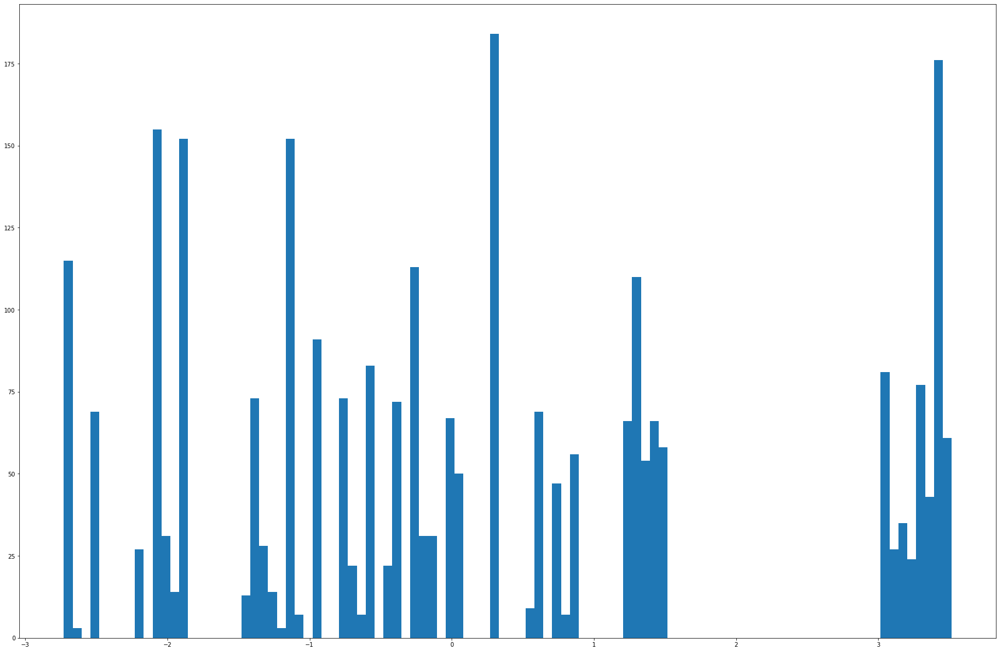

In [19]:
fig = plt.figure(figsize=(30,20))
plt.hist(X_embedded3D.T[0], bins=100)
plt.show()

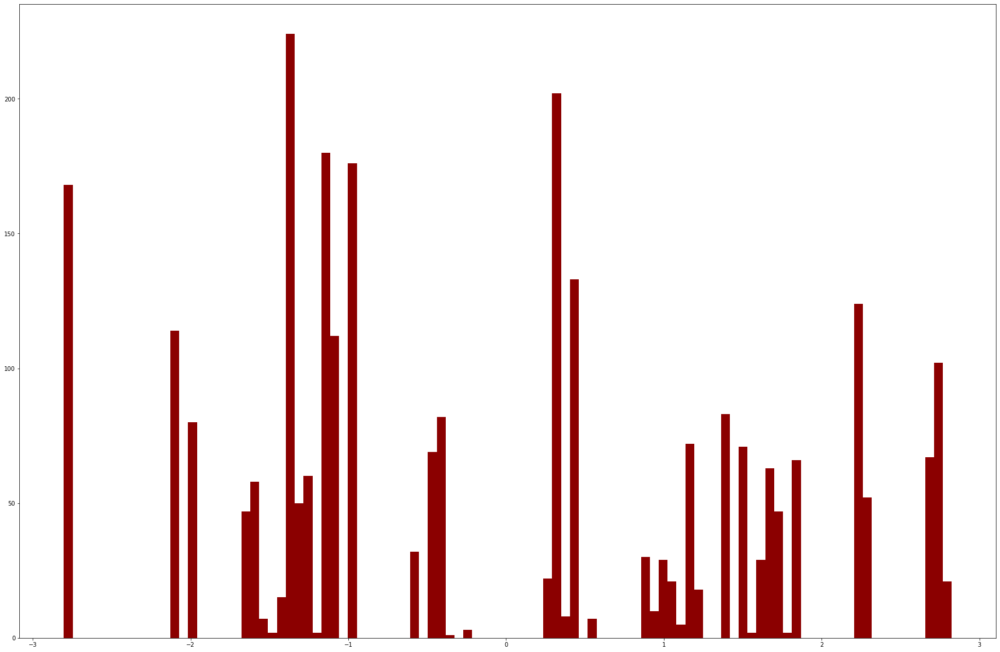

In [20]:
fig = plt.figure(figsize=(30,20))
plt.hist(X_embedded3D.T[1], color='darkred', bins=100)
plt.show()

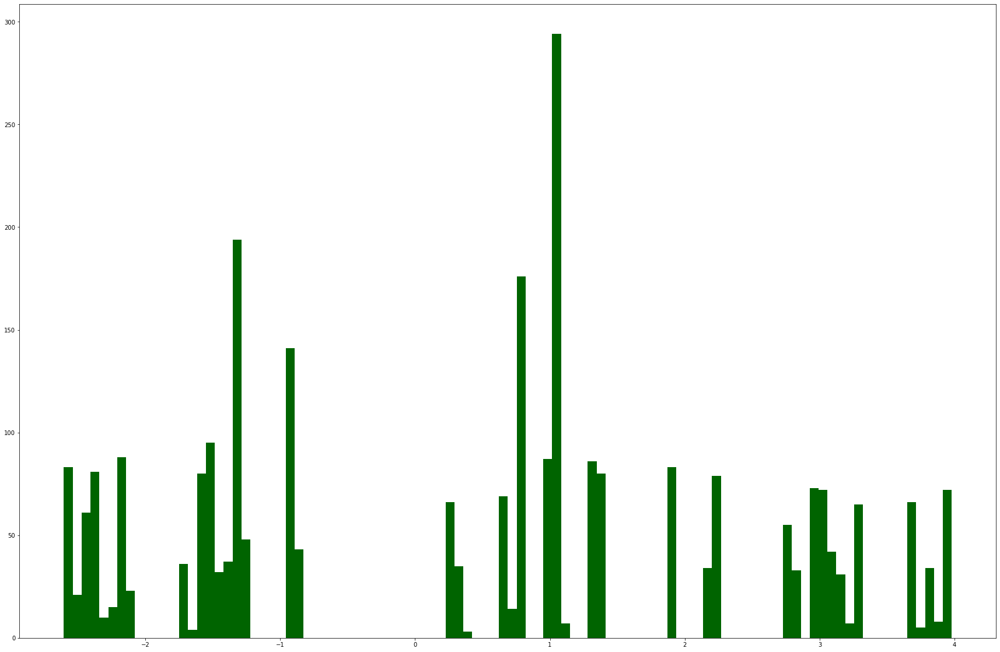

In [21]:
fig = plt.figure(figsize=(30,20))
plt.hist(X_embedded3D.T[2], color='darkgreen', bins=100)
plt.show()

In [24]:
fig3D, df3D = present_in_3D(data_train_preds, X_embedded3D)

In [26]:
original_df = pd.read_excel("/home/dzvinka/Enamine/yield_prediction/data/Buchwald_Hartwig.xlsx")
original_df.head()

,Ligand,Additive,Base,Aryl halide,Output
0,CC(C)C(C=C(C(C)C)C=C1C(C)C)=C1C2=C(P([C@@]3(C[...,CC1=CC(C)=NO1,CN(C)P(N(C)C)(N(C)C)=NP(N(C)C)(N(C)C)=NCC,ClC1=NC=CC=C1,70.410458
1,CC(C)C(C=C(C(C)C)C=C1C(C)C)=C1C2=C(P([C@@]3(C[...,O=C(OC)C1=CC=NO1,CN(C)P(N(C)C)(N(C)C)=NP(N(C)C)(N(C)C)=NCC,BrC1=NC=CC=C1,11.064457
2,CC(C)C(C=C(C(C)C)C=C1C(C)C)=C1C2=C(P(C3CCCCC3)...,O=C(OC)C1=CC=NO1,CN(C)P(N(C)C)(N(C)C)=NP(N(C)C)(N(C)C)=NCC,IC1=CC=C(CC)C=C1,10.223550
3,CC(C)C(C=C(C(C)C)C=C1C(C)C)=C1C2=C(P(C(C)(C)C)...,CCOC(C1=CON=C1)=O,CN1CCCN2C1=NCCC2,ClC1=CC=C(C(F)(F)F)C=C1,20.083383
4,CC(C)C(C=C(C(C)C)C=C1C(C)C)=C1C2=C(P([C@@]3(C[...,CC1=CC(C)=NO1,CN1CCCN2C1=NCCC2,ClC1=CC=C(OC)C=C1,0.492663


In [27]:
len(set(original_df['Additive']))

22

In [28]:
len(set(original_df['Base']))

3

In [29]:
len(set(original_df['Aryl halide']))

15

In [30]:
len(set(original_df['Ligand']))

4

In [31]:
original_df.shape

(3955, 5)

In [32]:
data_train_preds.head()

,rsmiles,psmiles,YIELD,predicted,label,reaction class,num not zero atoms
0,[CH3:8][c:9]1[cH:10][cH:11][c:12]([NH2:13])[cH...,[c:2]1([NH:13][c:12]2[cH:11][cH:10][c:9]([CH3:...,0.692304,1,0,0,3
1,[CH3:8][c:9]1[cH:10][cH:11][c:12]([NH2:13])[cH...,[c:2]1([NH:13][c:12]2[cH:11][cH:10][c:9]([CH3:...,0.110176,0,0,0,5
2,[CH3:10][c:11]1[cH:12][cH:13][c:14]([NH2:15])[...,[CH3:1][CH2:2][c:3]1[cH:4][cH:5][c:6]([NH:15][...,0.088796,0,0,0,6
3,[CH3:12][c:13]1[cH:14][cH:15][c:16]([NH2:17])[...,[F:1][C:2]([F:3])([F:4])[c:5]1[cH:6][cH:7][c:8...,0.204815,0,0,0,6
4,[CH3:10][c:11]1[cH:12][cH:13][c:14]([NH2:15])[...,[CH3:1][O:2][c:3]1[cH:4][cH:5][c:6]([NH:15][c:...,0.004132,0,0,0,4


In [33]:
data_train_preds.shape

(2768, 7)

## Cosine similarity?))
https://www.google.com/url?sa=i&url=https%3A%2F%2Fneo4j.com%2Fdocs%2Fgraph-data-science%2Fcurrent%2Falpha-algorithms%2Fcosine%2F&psig=AOvVaw2W_Wuzu6u-lgmSrjrKJJye&ust=1623785264137000&source=images&cd=vfe&ved=0CAIQjRxqFwoTCPjZ5dDtl_ECFQAAAAAdAAAAABAD![image.png](attachment:image.png)

No handles with labels found to put in legend.


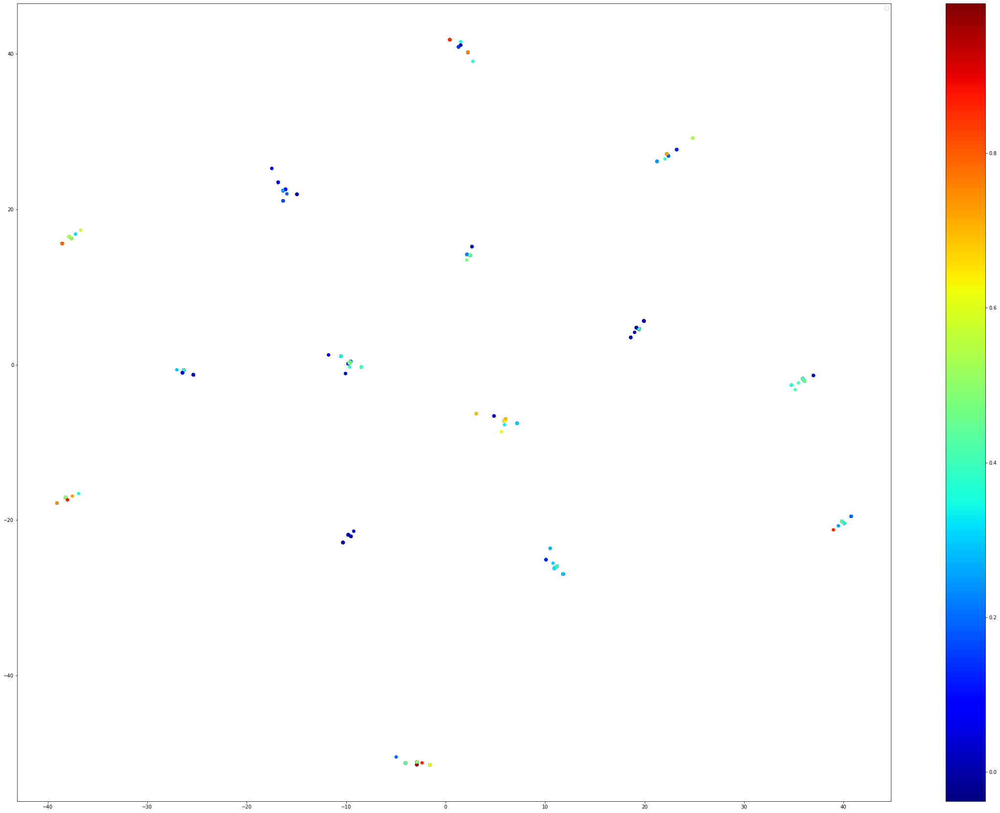

In [37]:
def hyperparams_tsne(perplexity = 30, metric = 'euclidean', learning_rate = 200.0):
    
    X2D = representations_copy[entries_names].to_numpy()
    X_embedded2D = TSNE(n_components=2, perplexity=perplexity, metric = metric, learning_rate = learning_rate).fit_transform(X2D)
    
    present_in_2D(data_train_preds, X_embedded2D)

    X3D = representations_copy[entries_names].to_numpy()
    X_embedded3D = TSNE(n_components=3,  perplexity=perplexity, metric = metric, learning_rate = learning_rate).fit_transform(X3D)
    fig, df = present_in_3D(data_train_preds, X_embedded3D)
    fig.show()

hyperparams_tsne()
    

No handles with labels found to put in legend.


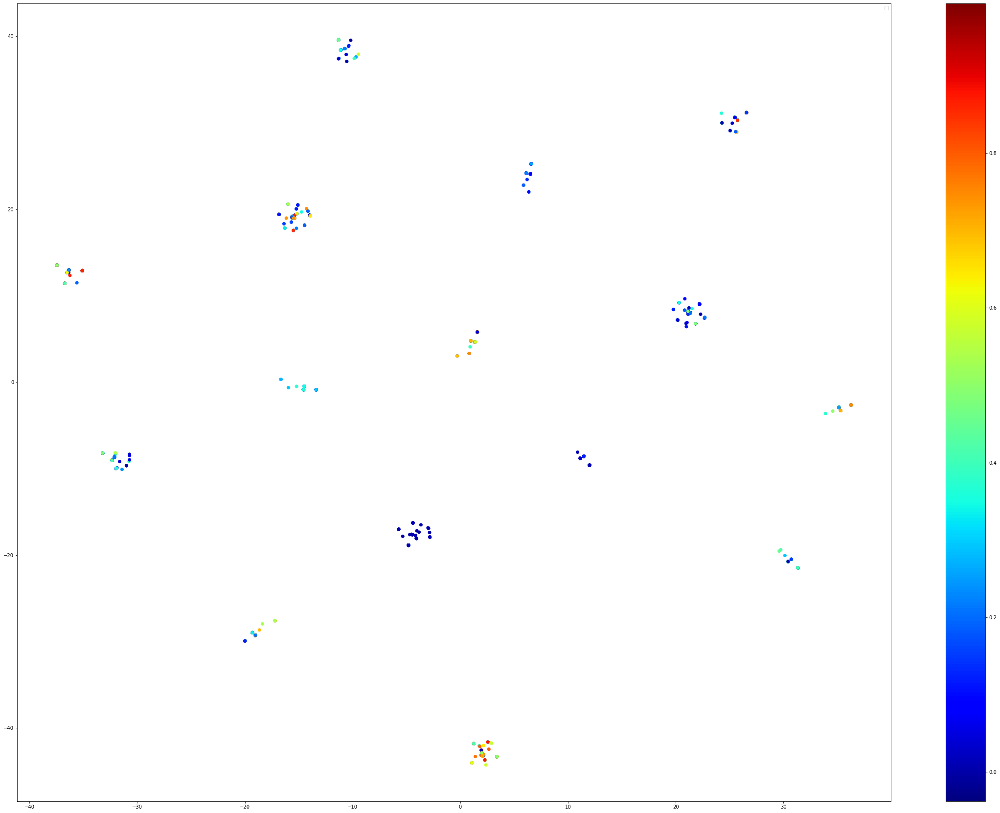

In [38]:
hyperparams_tsne(metric = 'cosine')

No handles with labels found to put in legend.


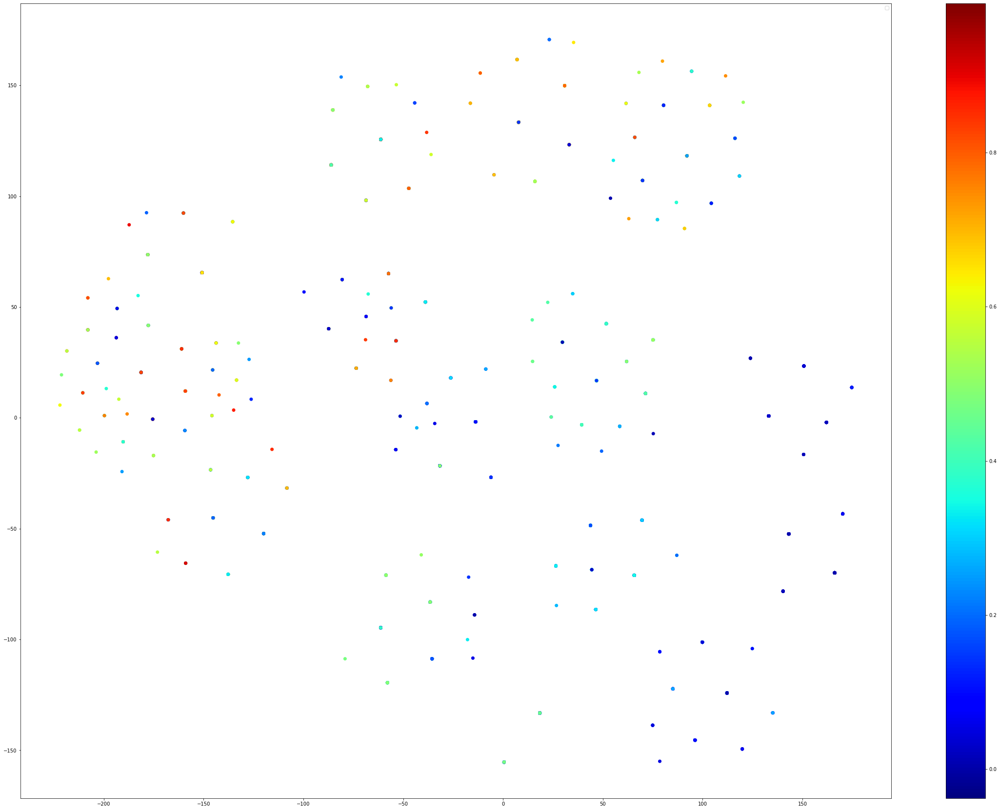

In [39]:
hyperparams_tsne(metric = 'cosine', perplexity = 700)

Perplexity =  10


No handles with labels found to put in legend.


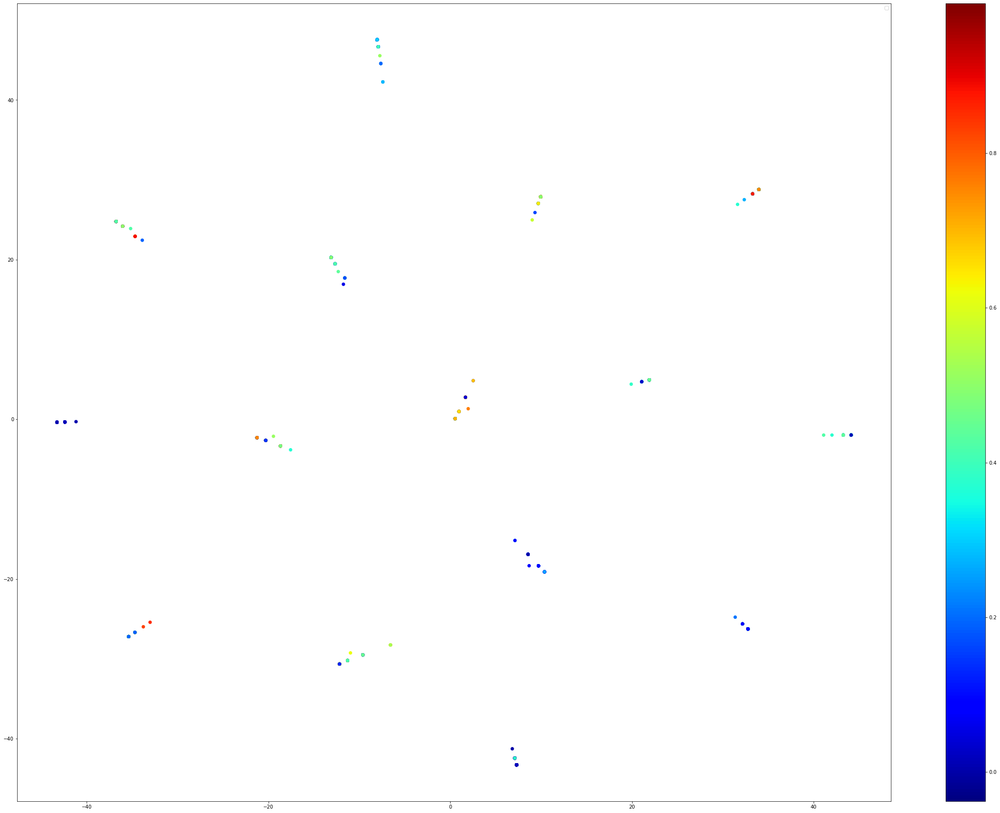

Perplexity =  30


No handles with labels found to put in legend.


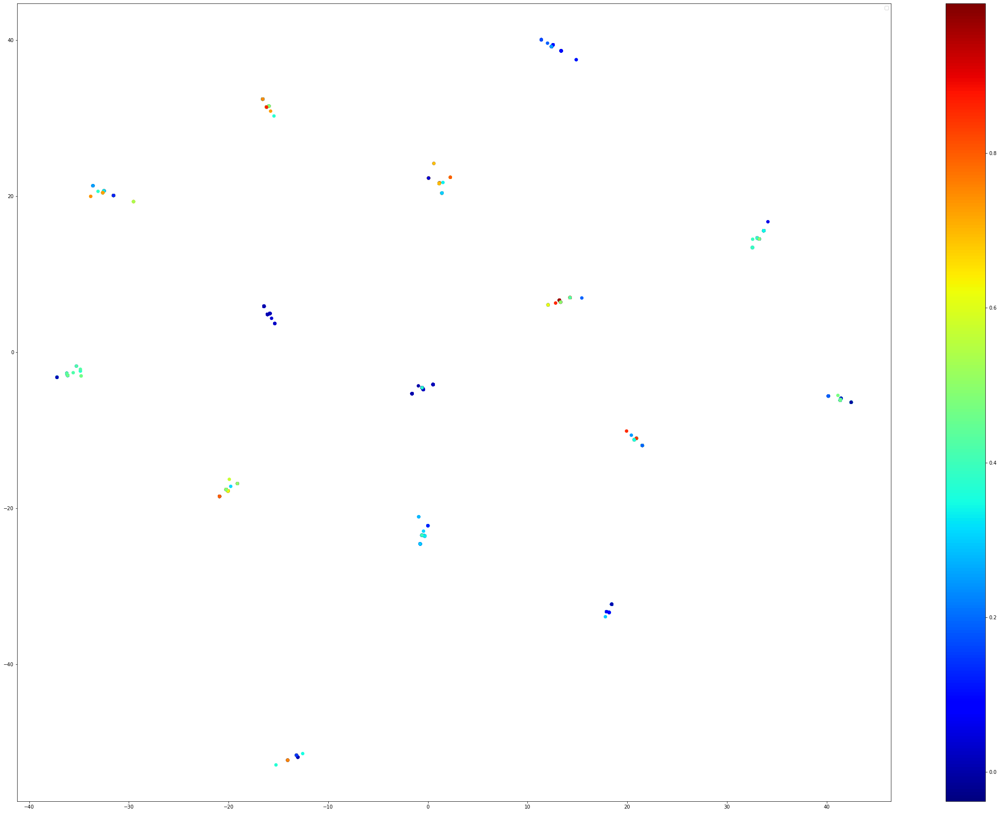

Perplexity =  50


No handles with labels found to put in legend.


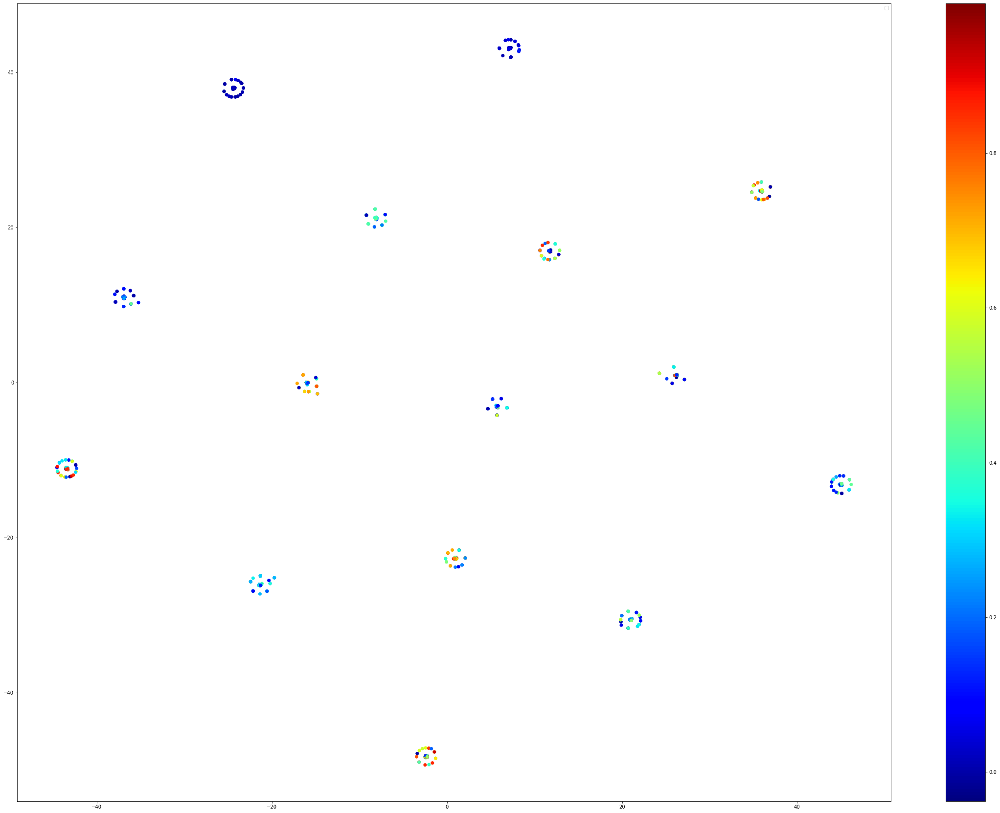

Perplexity =  70


No handles with labels found to put in legend.


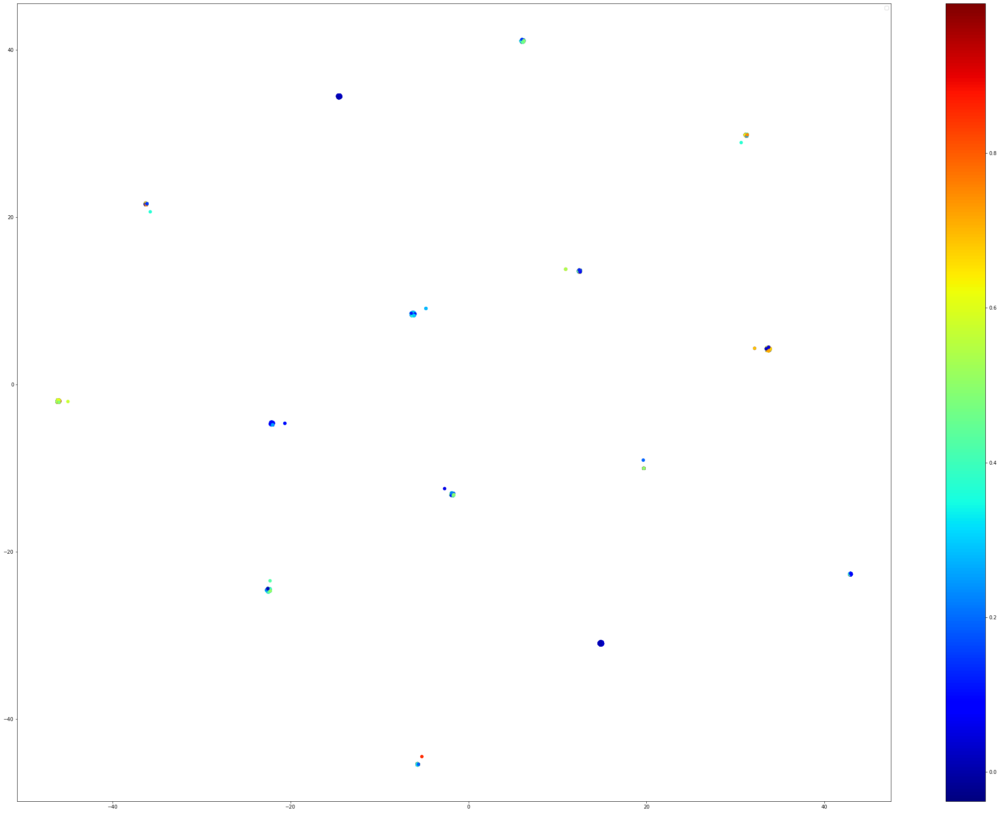

Perplexity =  90


No handles with labels found to put in legend.


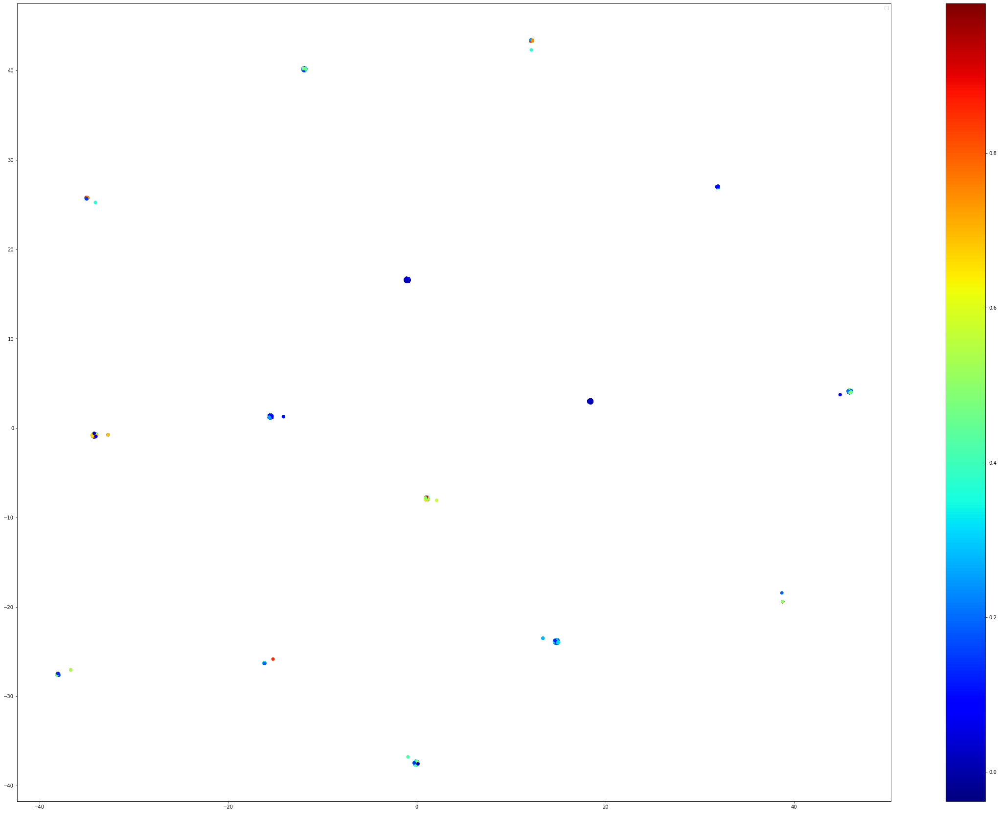

Perplexity =  111


No handles with labels found to put in legend.


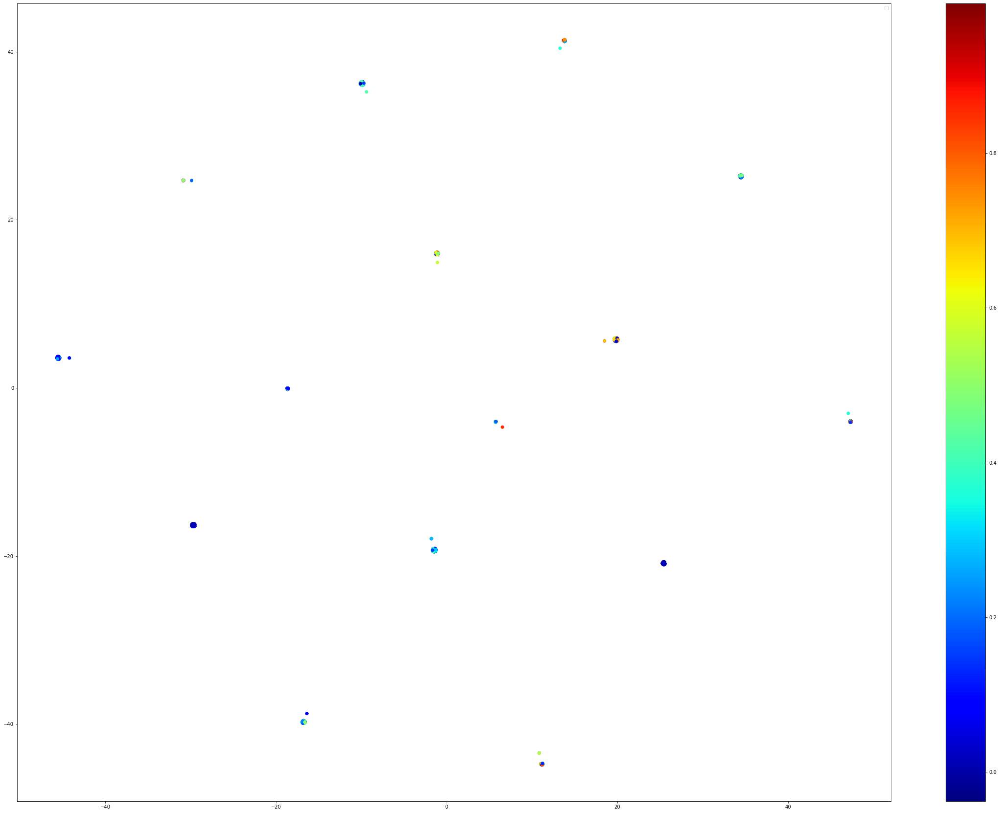

Perplexity =  131


No handles with labels found to put in legend.


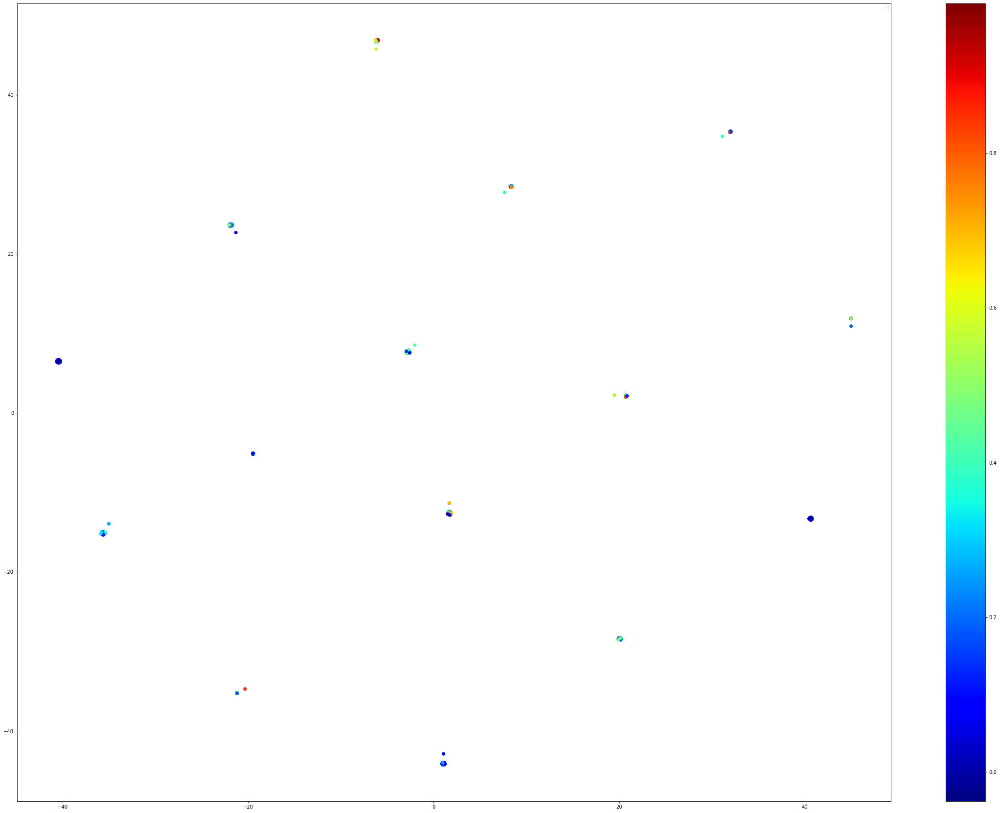

Perplexity =  151


No handles with labels found to put in legend.


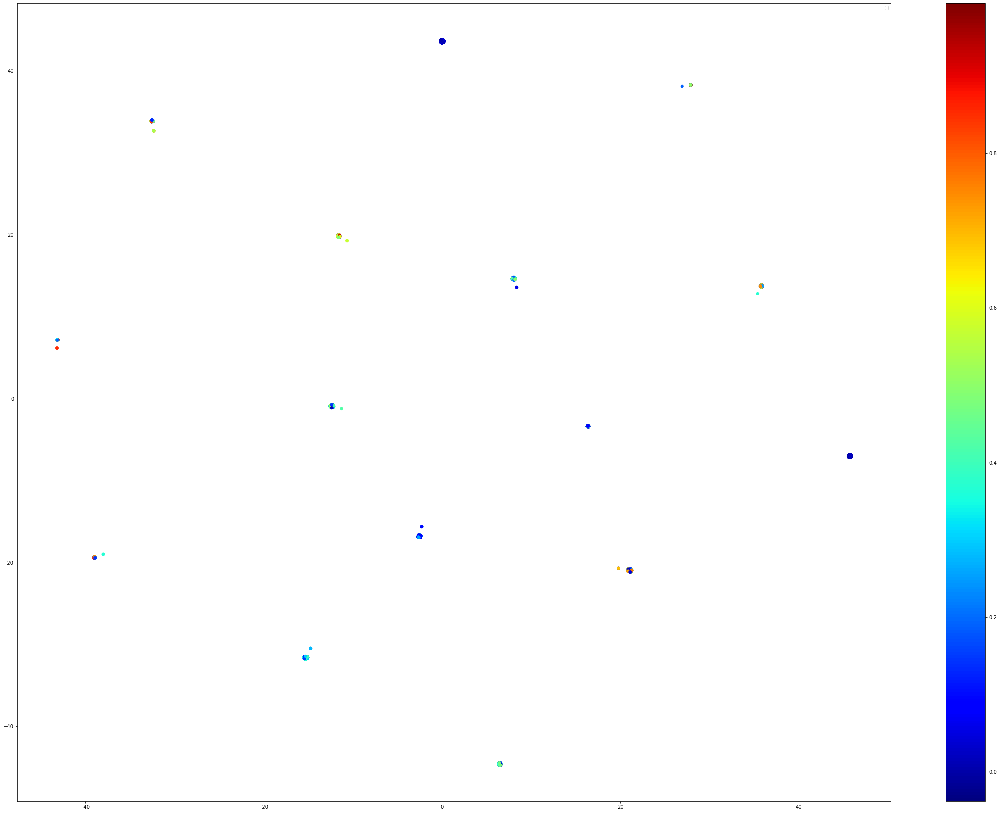

Perplexity =  171


No handles with labels found to put in legend.


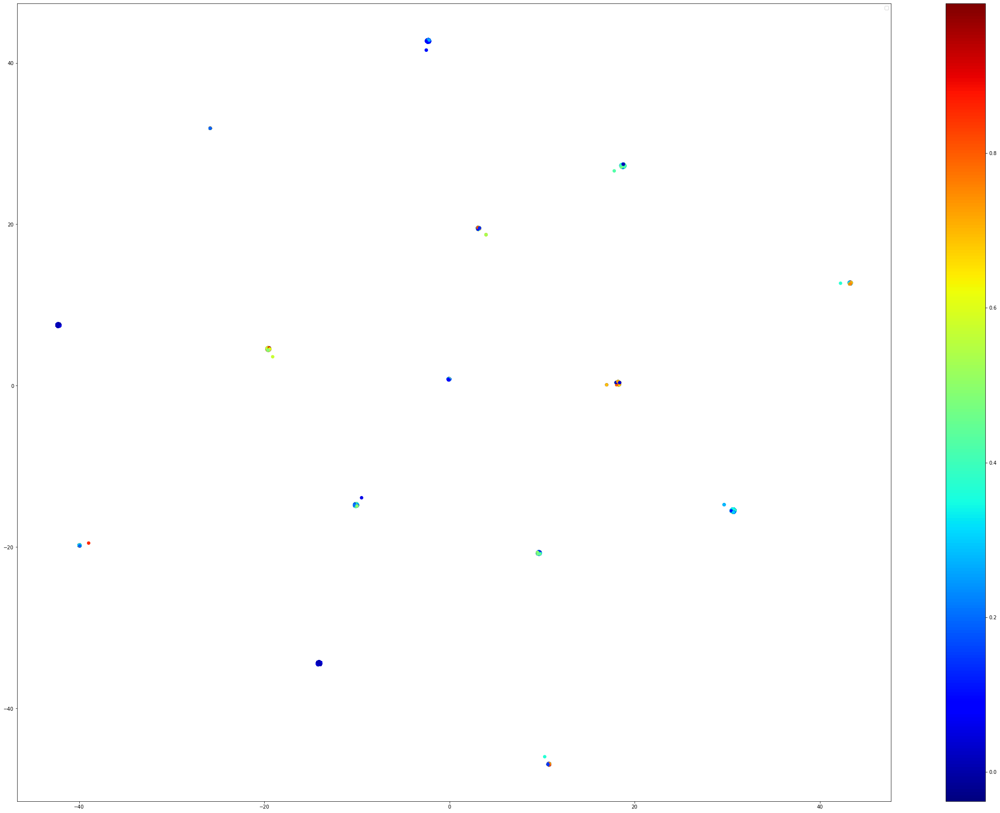

Perplexity =  191


No handles with labels found to put in legend.


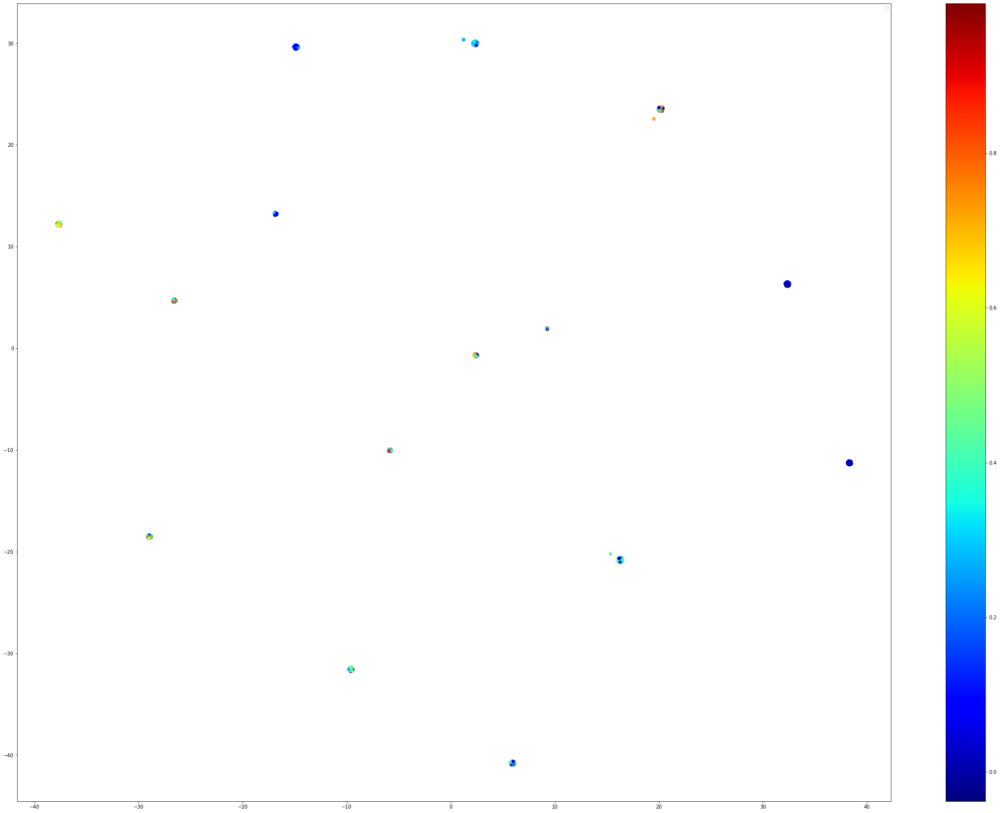

Perplexity =  212


No handles with labels found to put in legend.


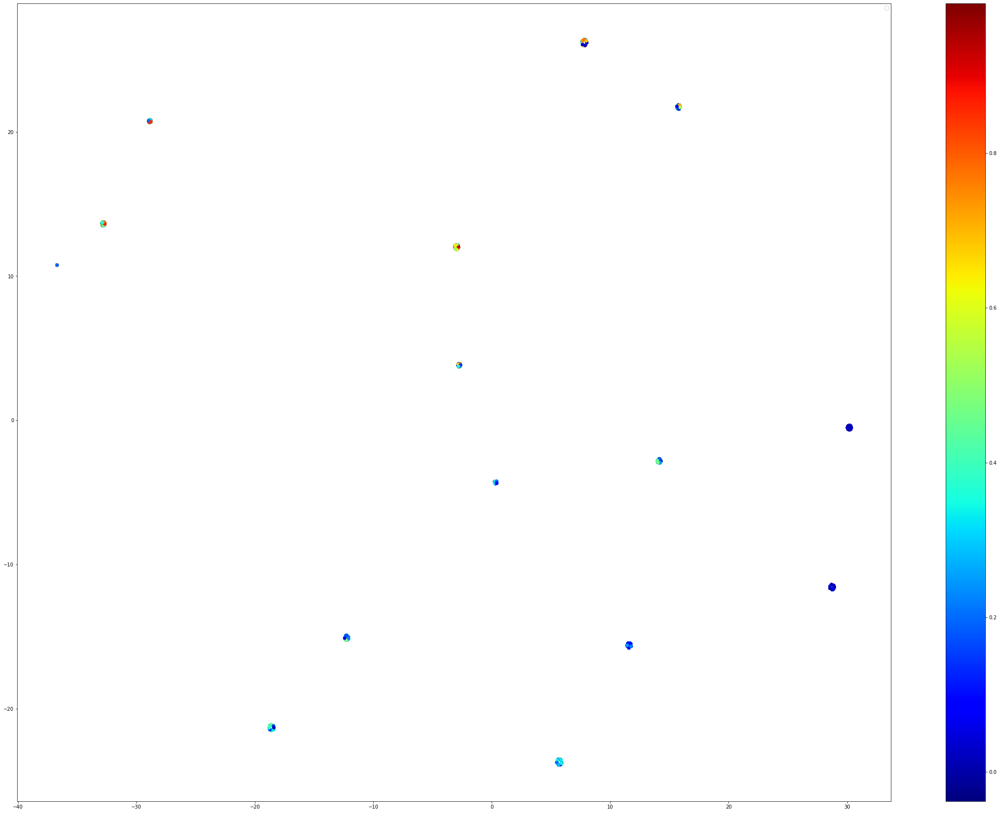

Perplexity =  232


No handles with labels found to put in legend.


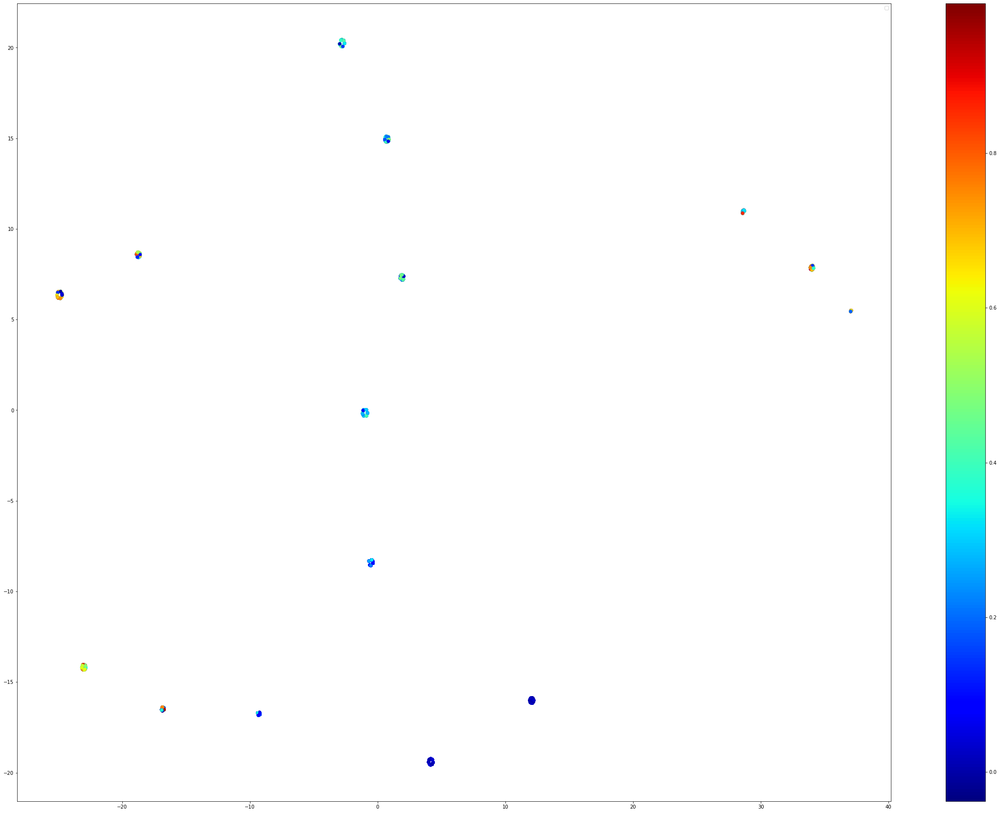

Perplexity =  252


No handles with labels found to put in legend.


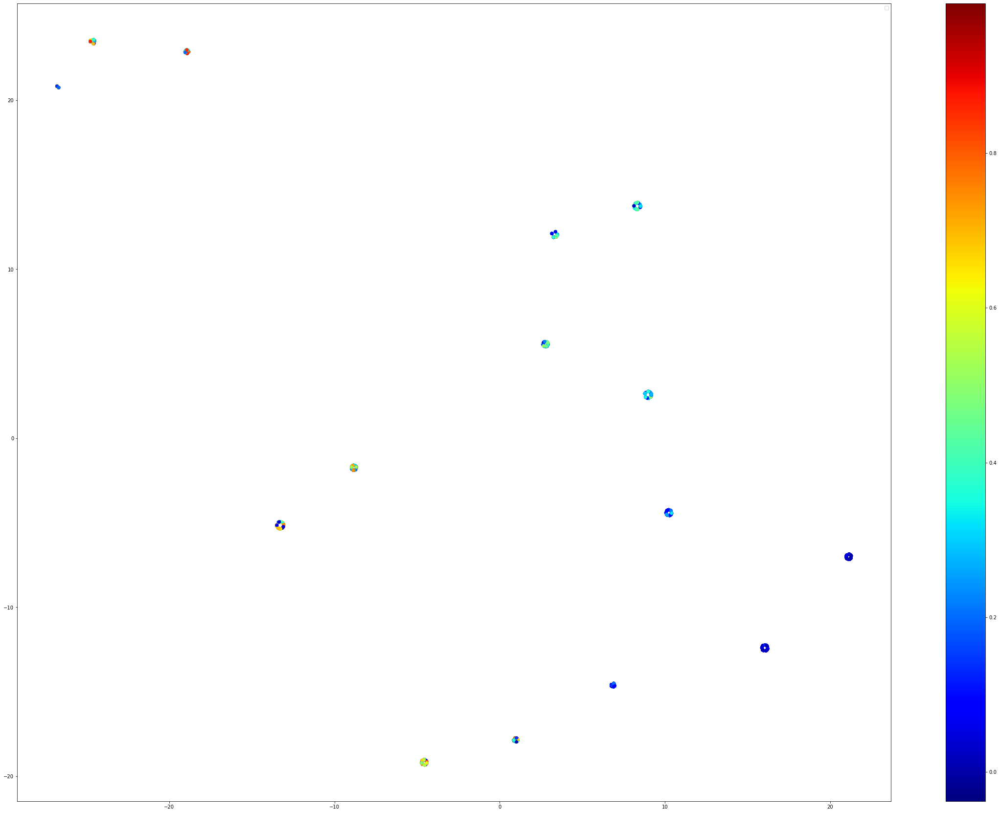

Perplexity =  272


No handles with labels found to put in legend.


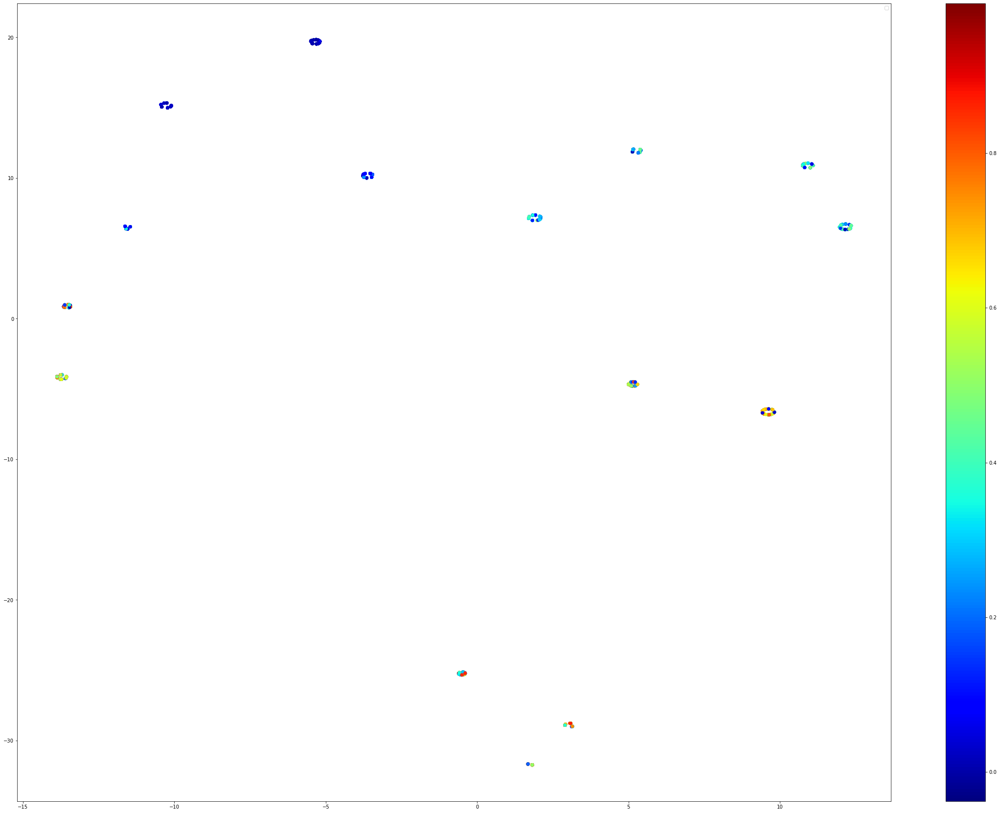

Perplexity =  292


No handles with labels found to put in legend.


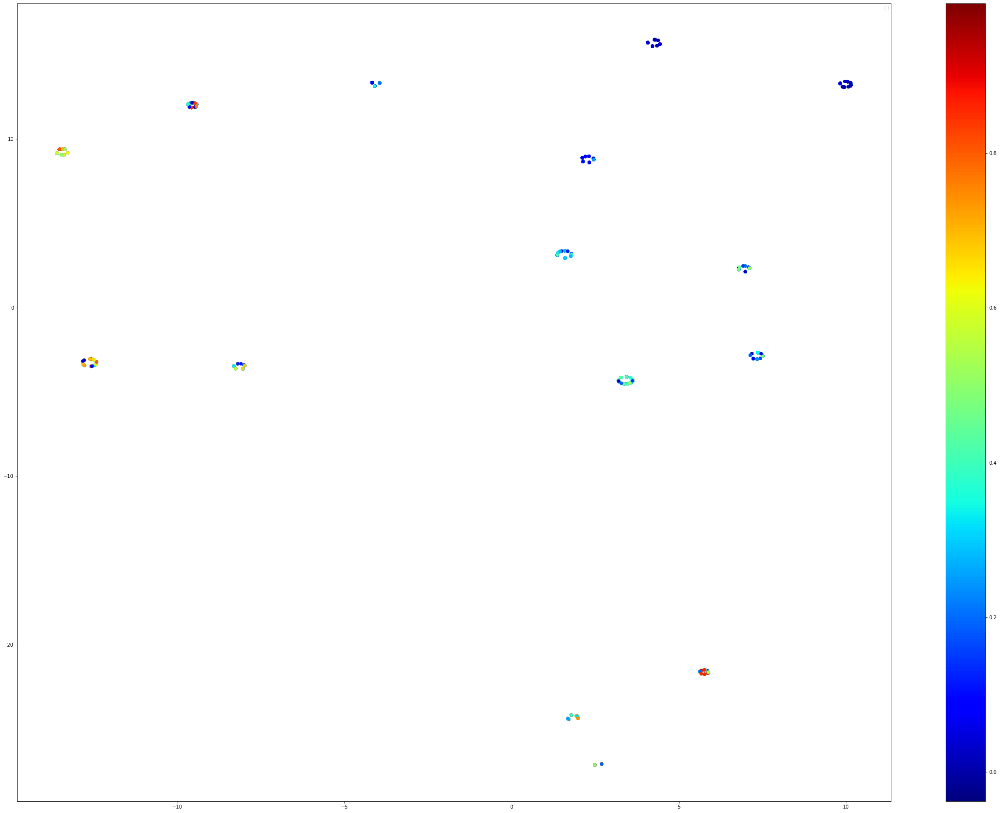

Perplexity =  313


No handles with labels found to put in legend.


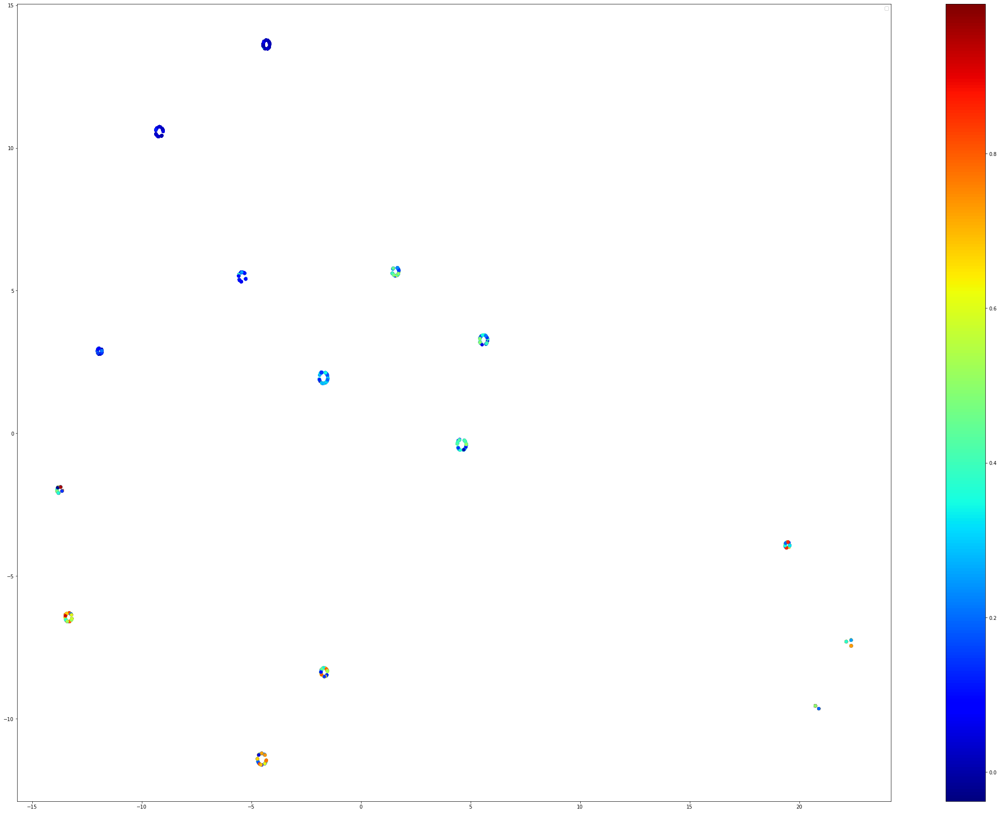

Perplexity =  333


No handles with labels found to put in legend.


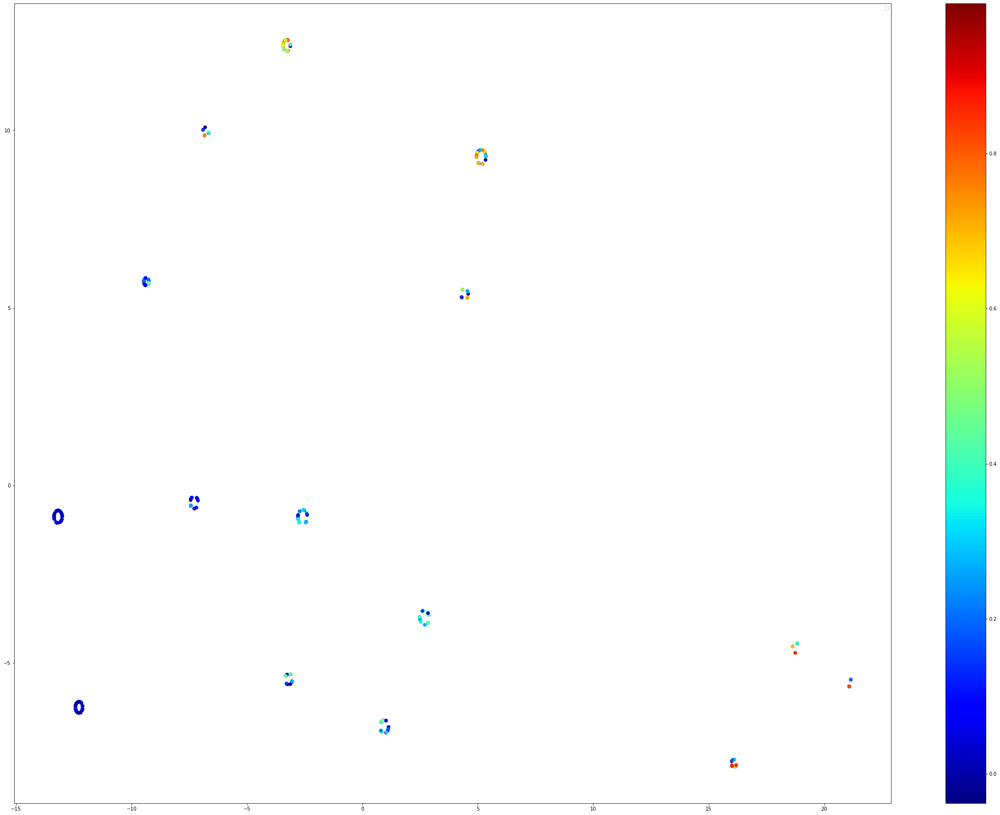

Perplexity =  353


No handles with labels found to put in legend.


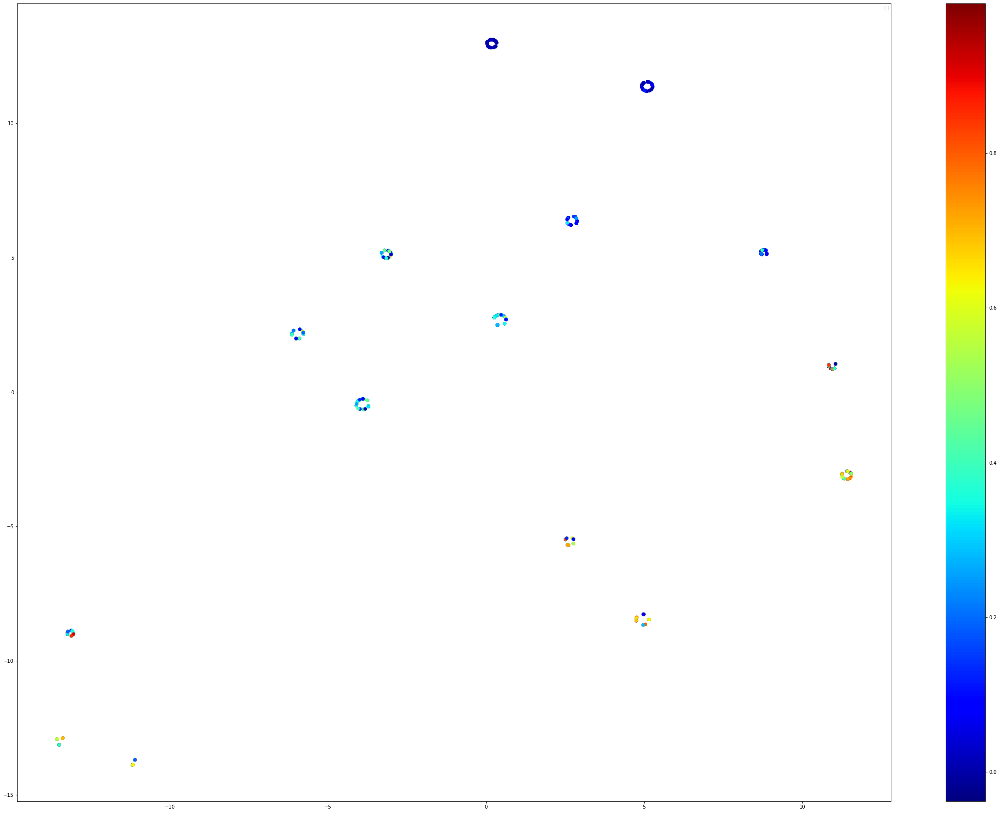

Perplexity =  373


No handles with labels found to put in legend.


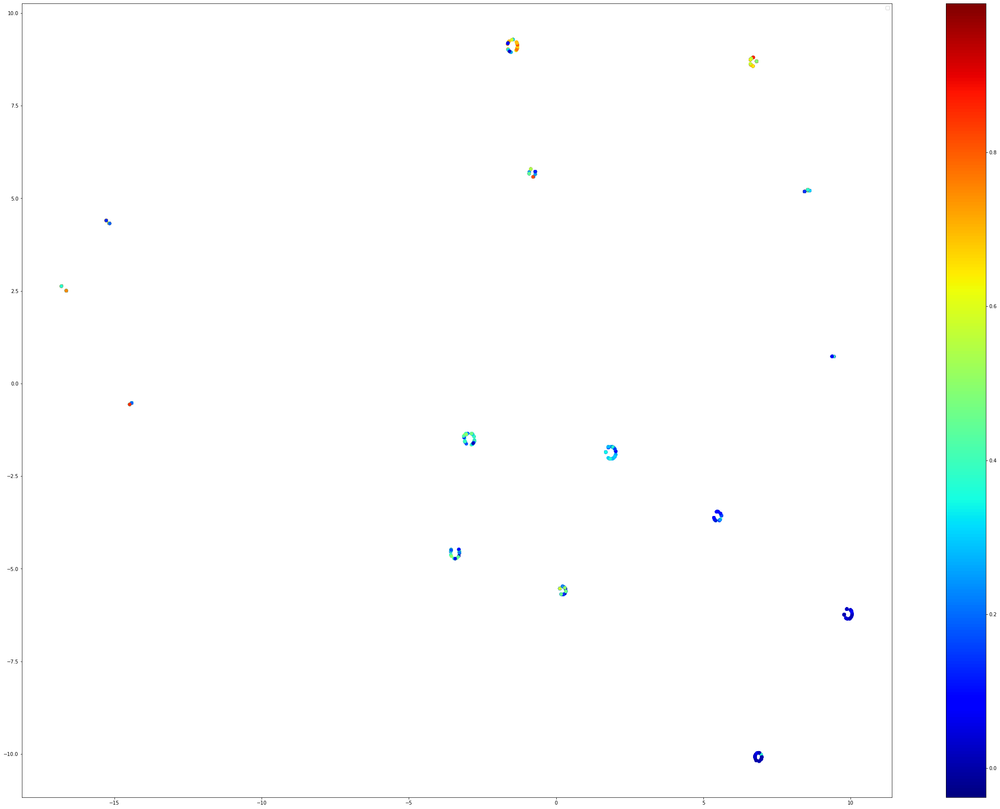

Perplexity =  393


No handles with labels found to put in legend.


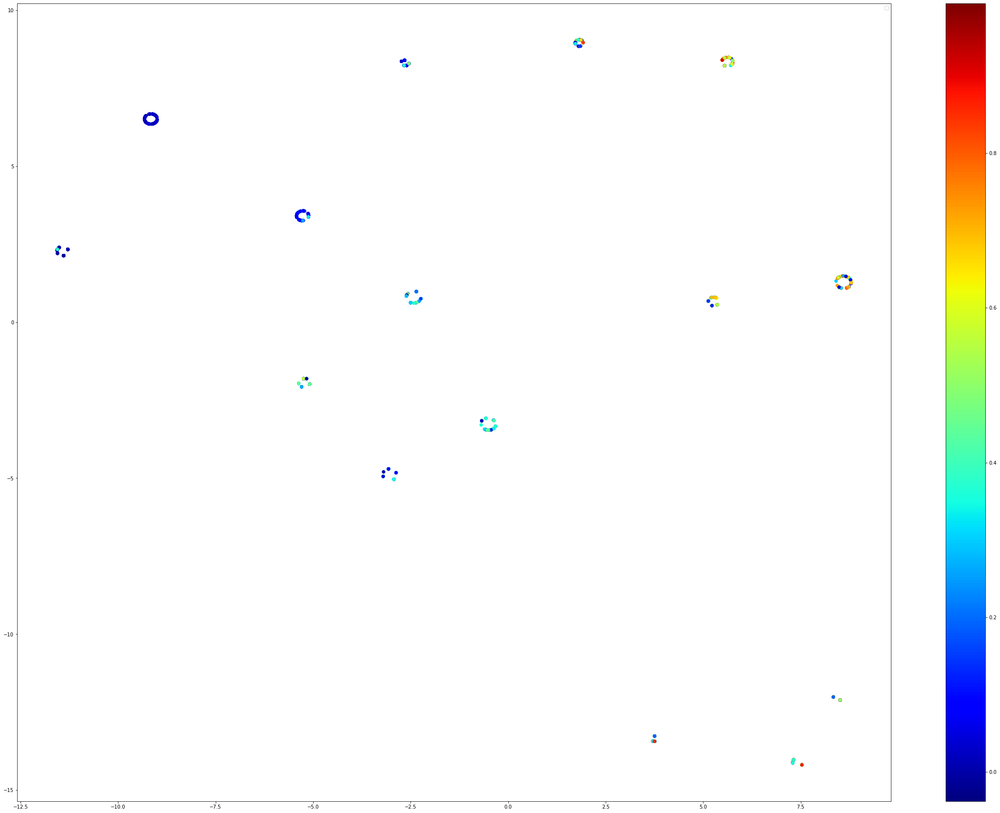

Perplexity =  414


No handles with labels found to put in legend.


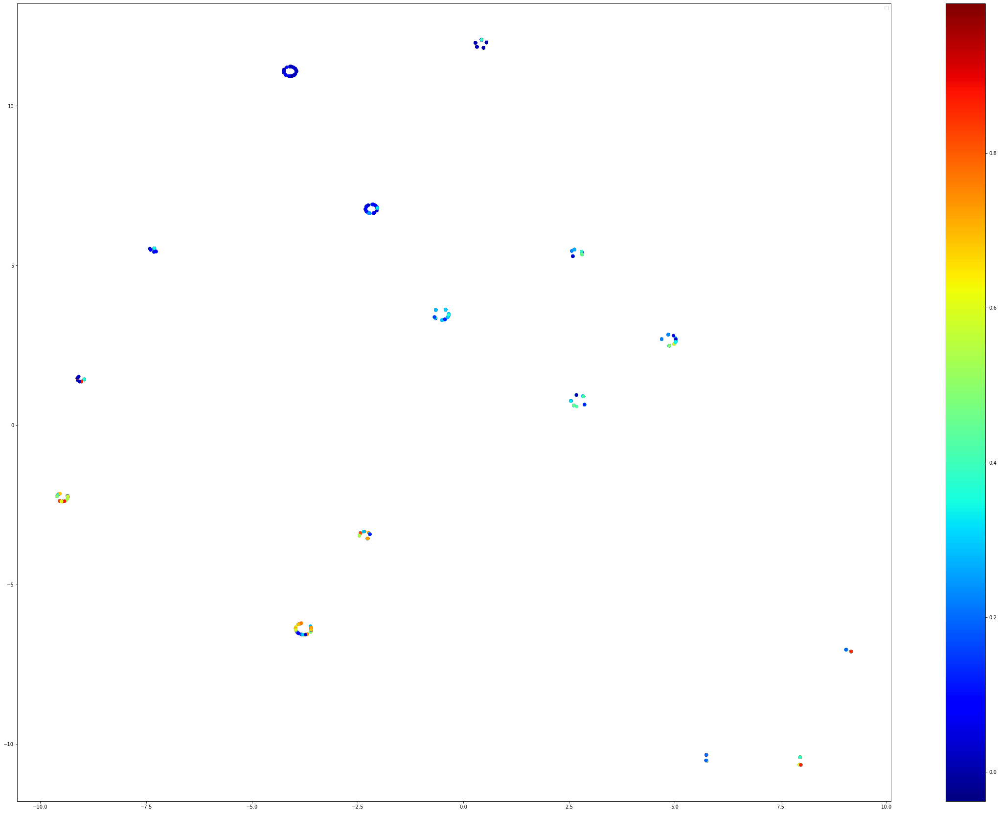

Perplexity =  434


No handles with labels found to put in legend.


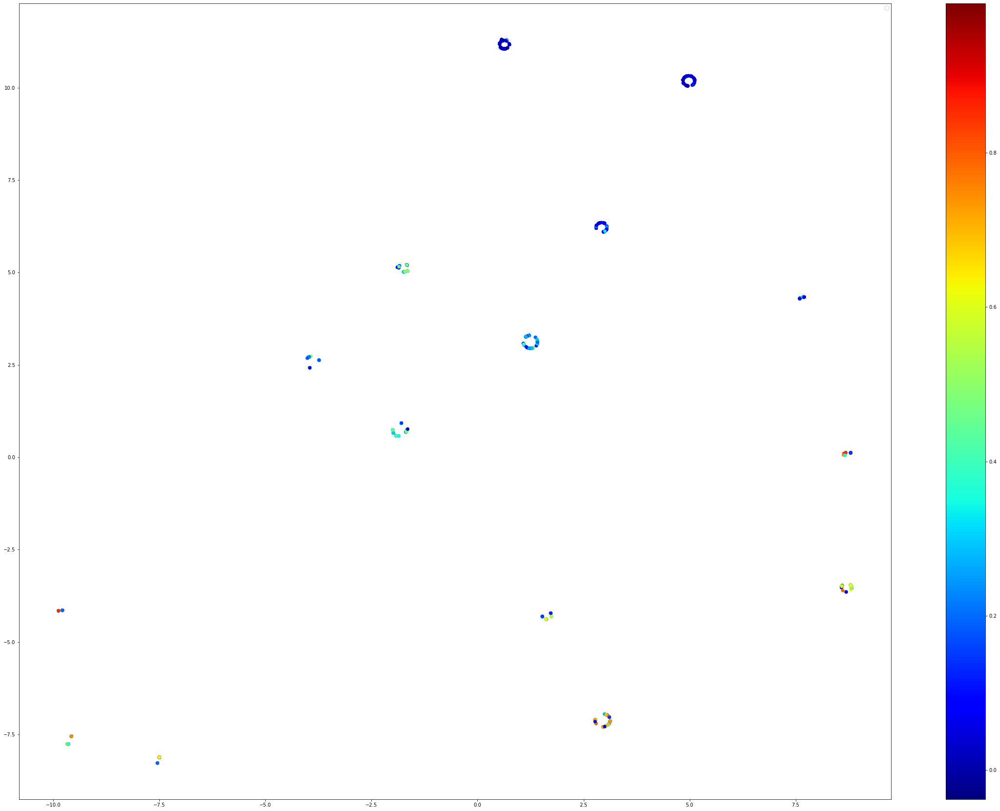

Perplexity =  454


No handles with labels found to put in legend.


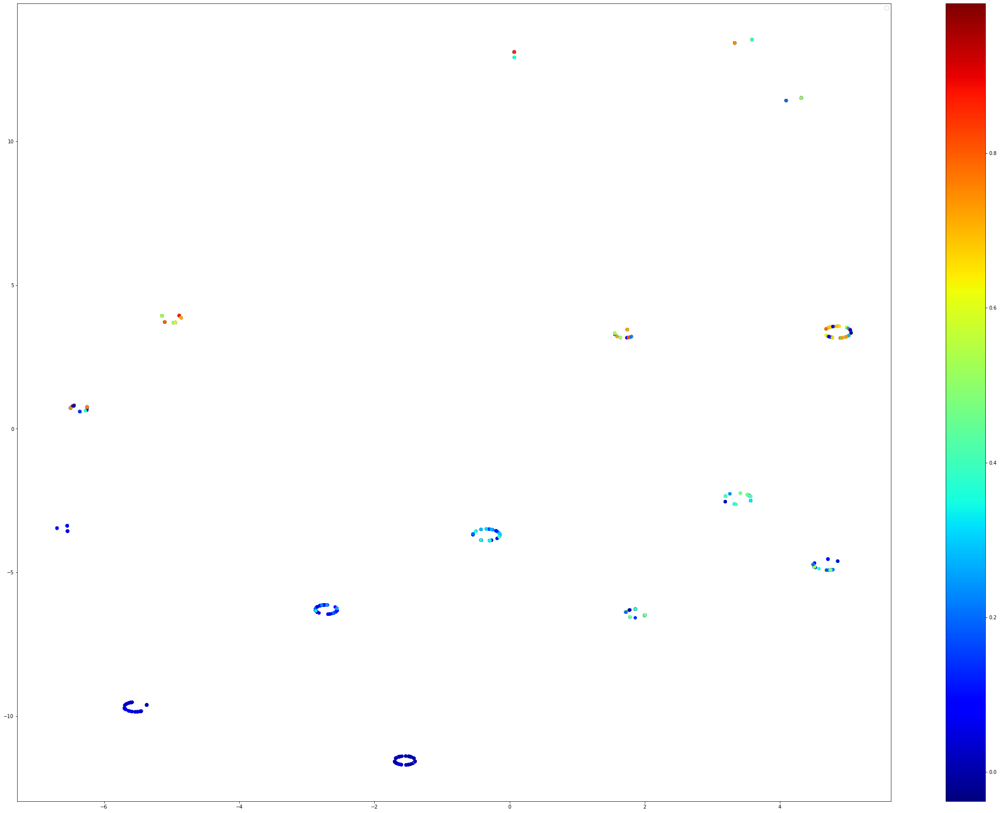

Perplexity =  474


No handles with labels found to put in legend.


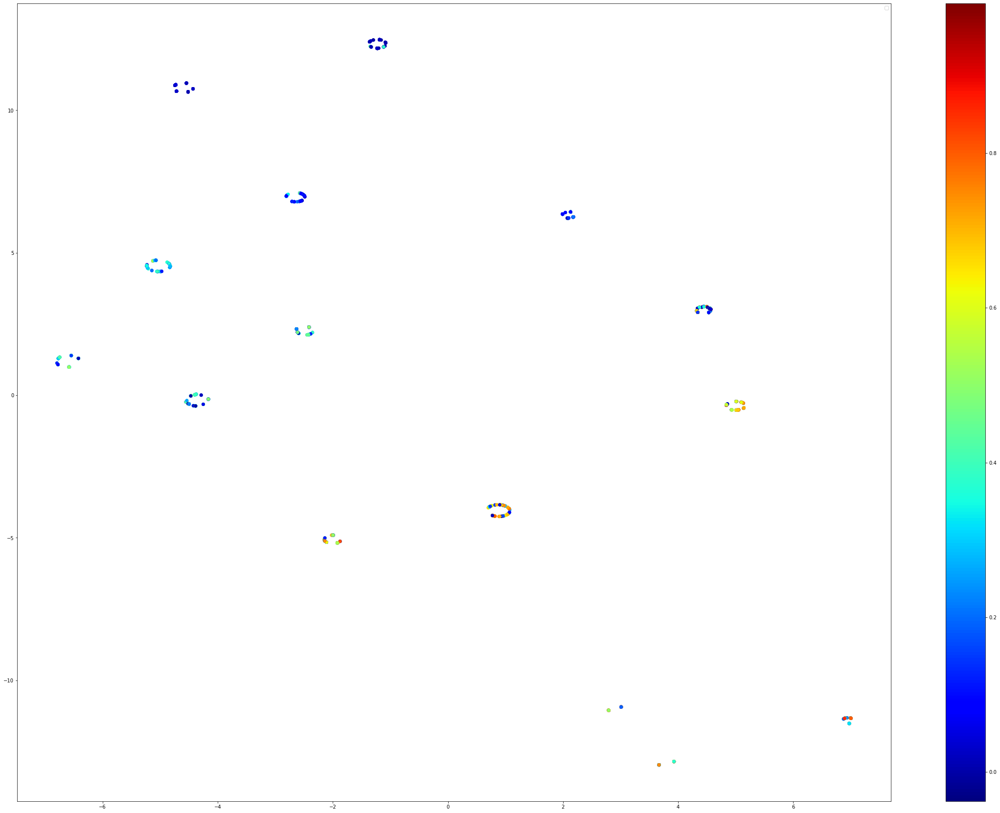

Perplexity =  494


No handles with labels found to put in legend.


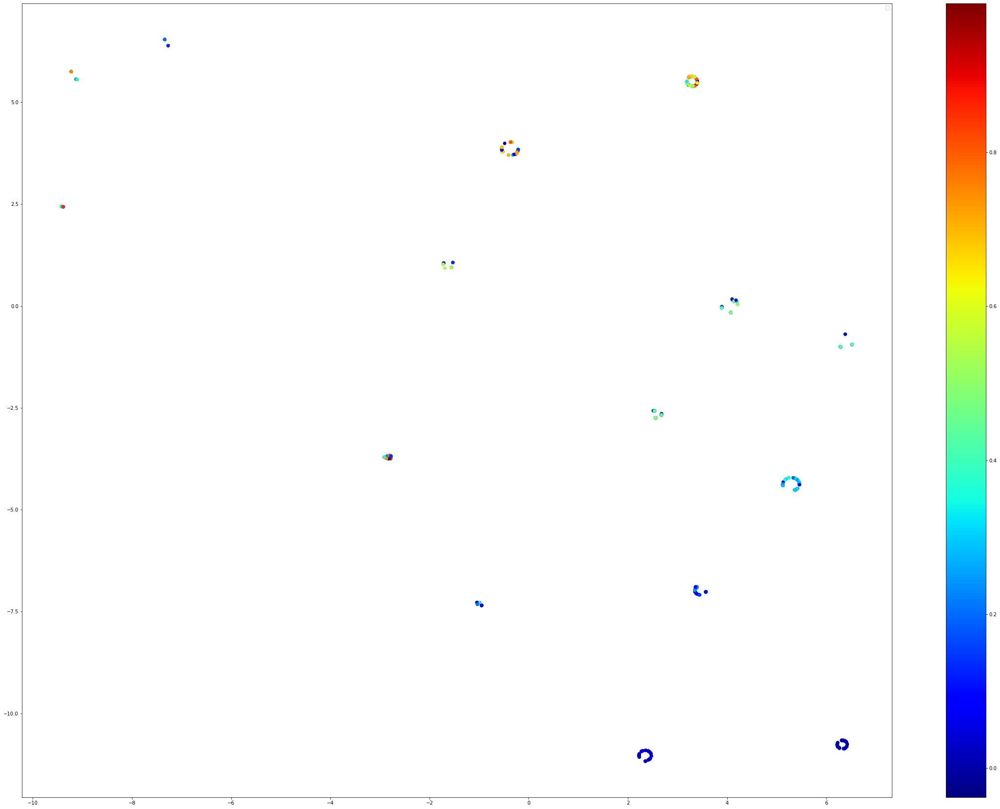

Perplexity =  515


No handles with labels found to put in legend.


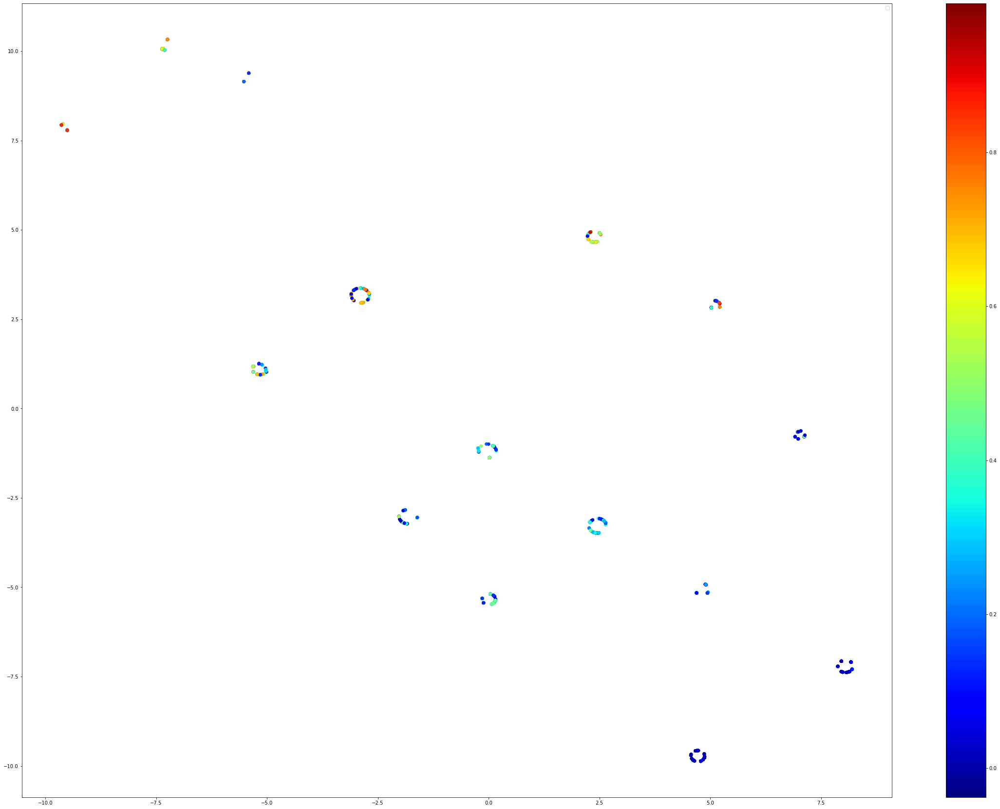

Perplexity =  535


No handles with labels found to put in legend.


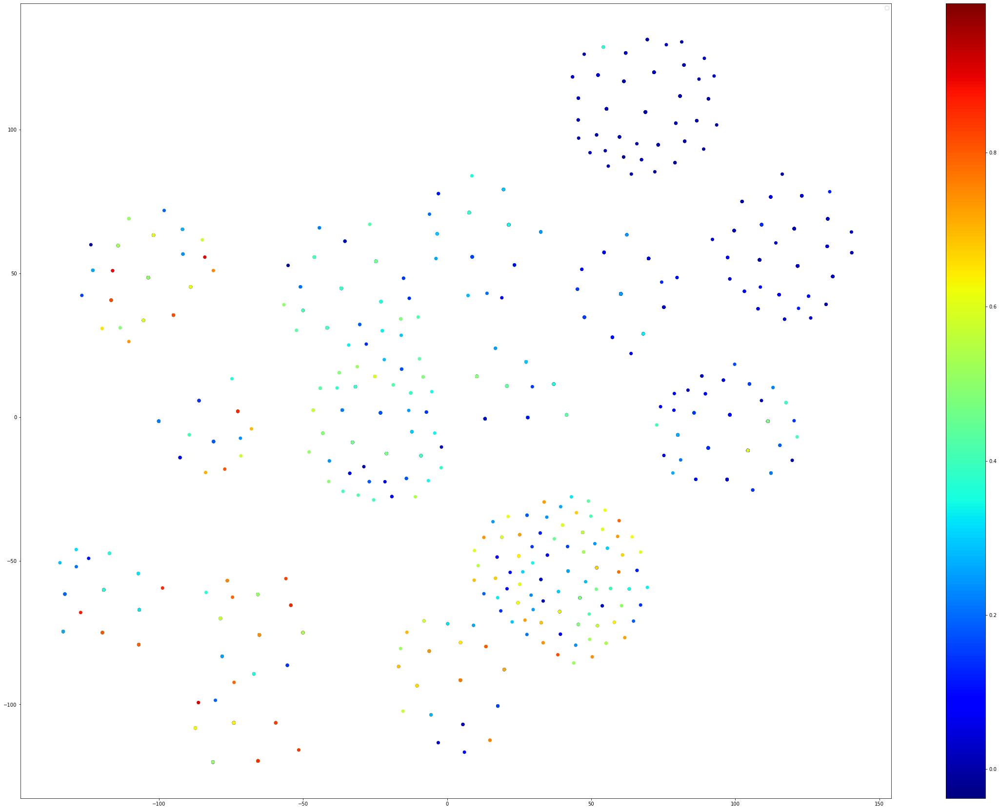

Perplexity =  555


No handles with labels found to put in legend.


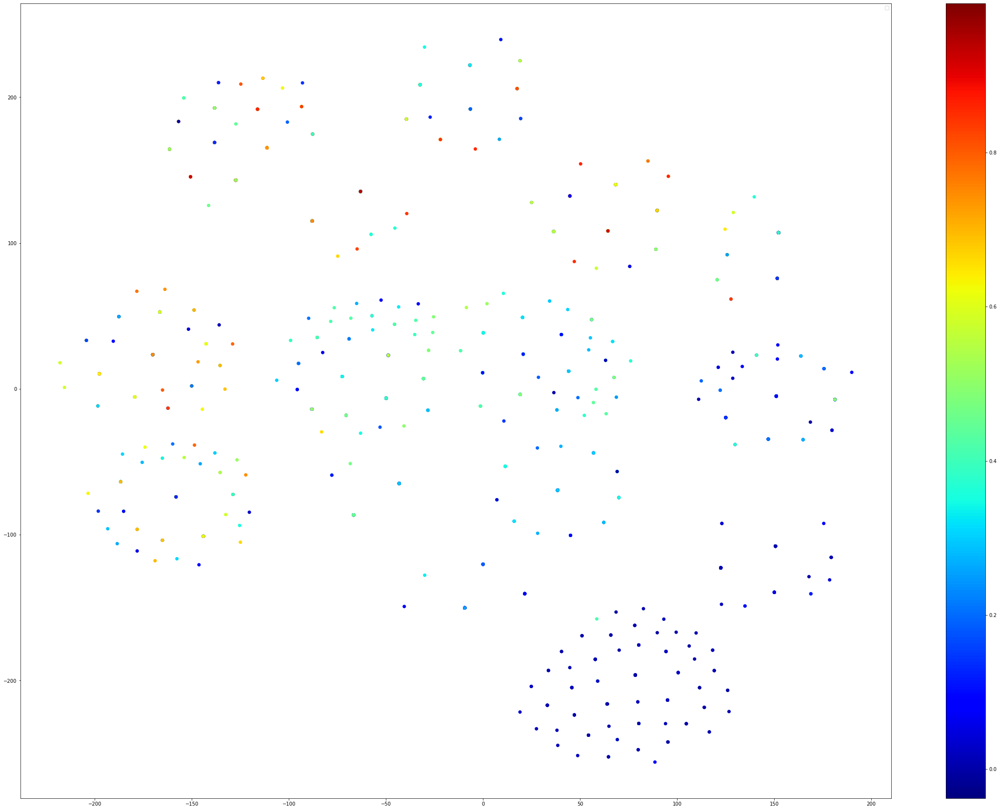

Perplexity =  575


No handles with labels found to put in legend.


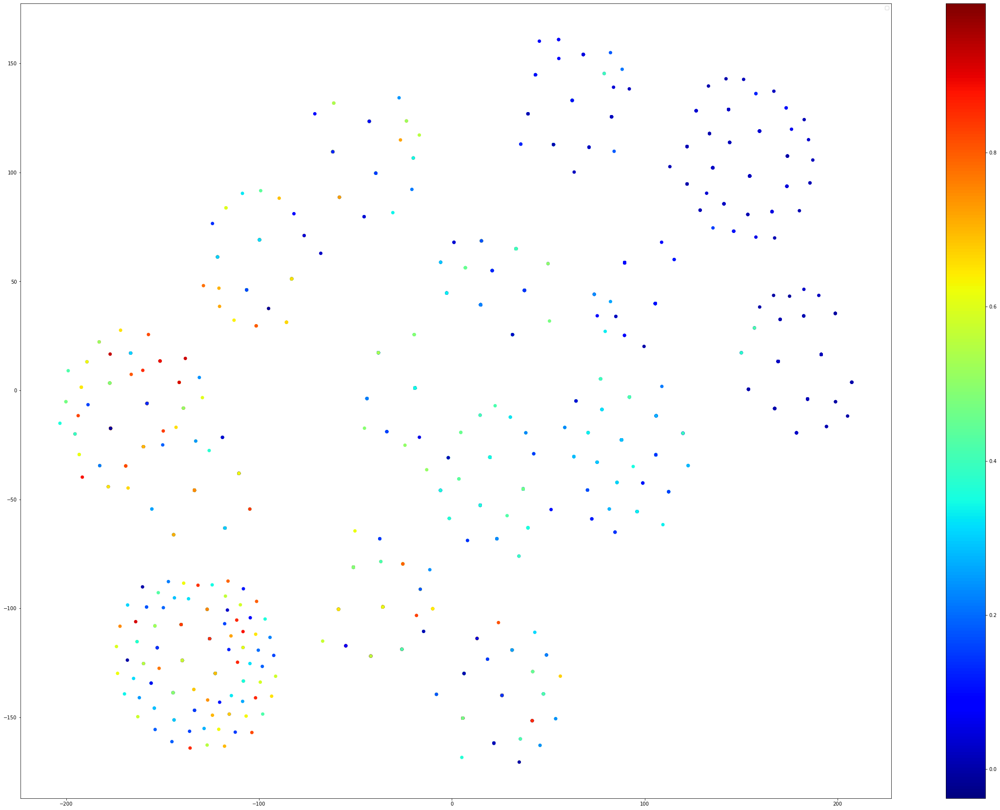

Perplexity =  595


No handles with labels found to put in legend.


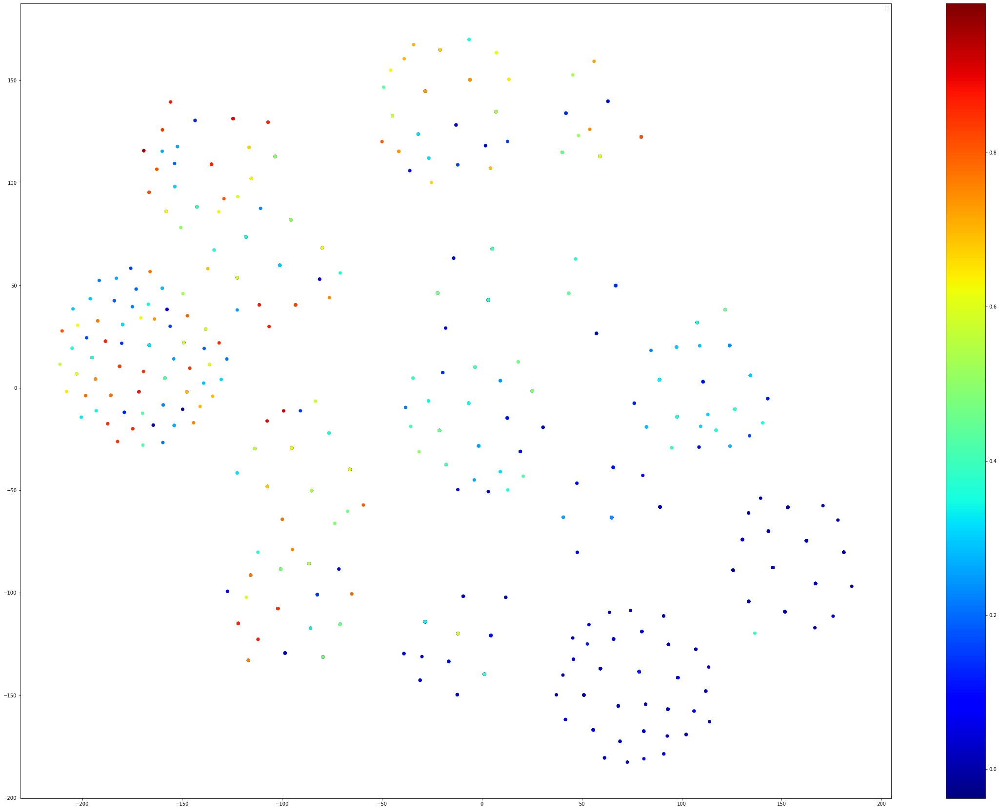

Perplexity =  616


No handles with labels found to put in legend.


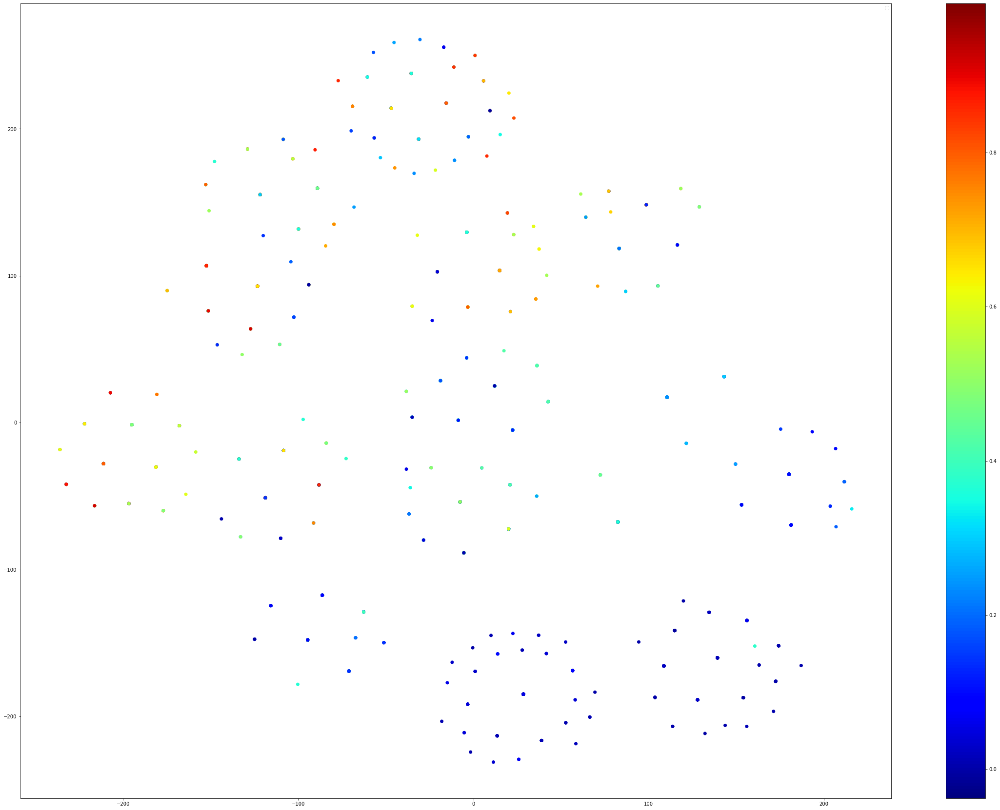

Perplexity =  636


No handles with labels found to put in legend.


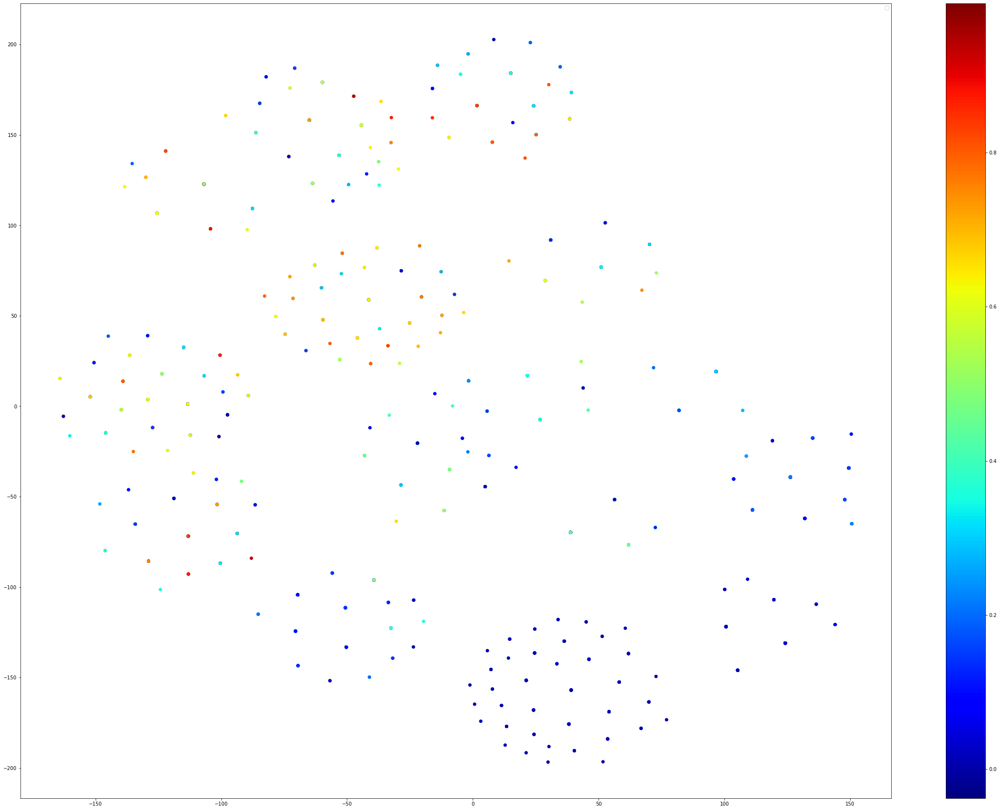

Perplexity =  656


No handles with labels found to put in legend.


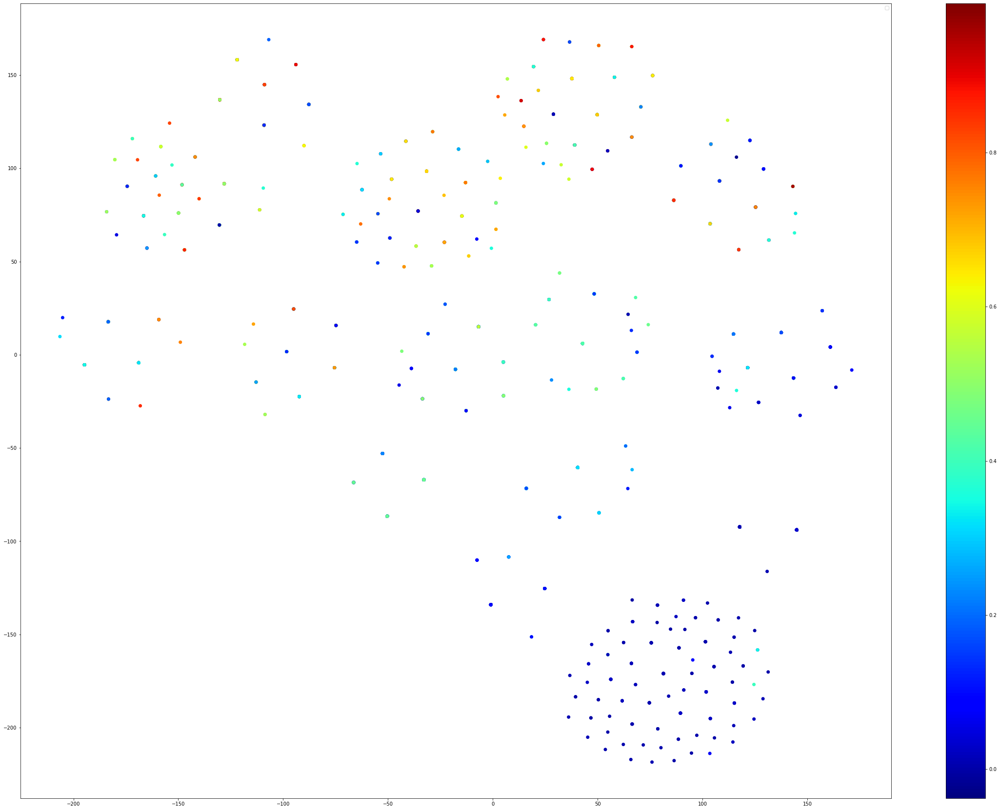

Perplexity =  676


No handles with labels found to put in legend.


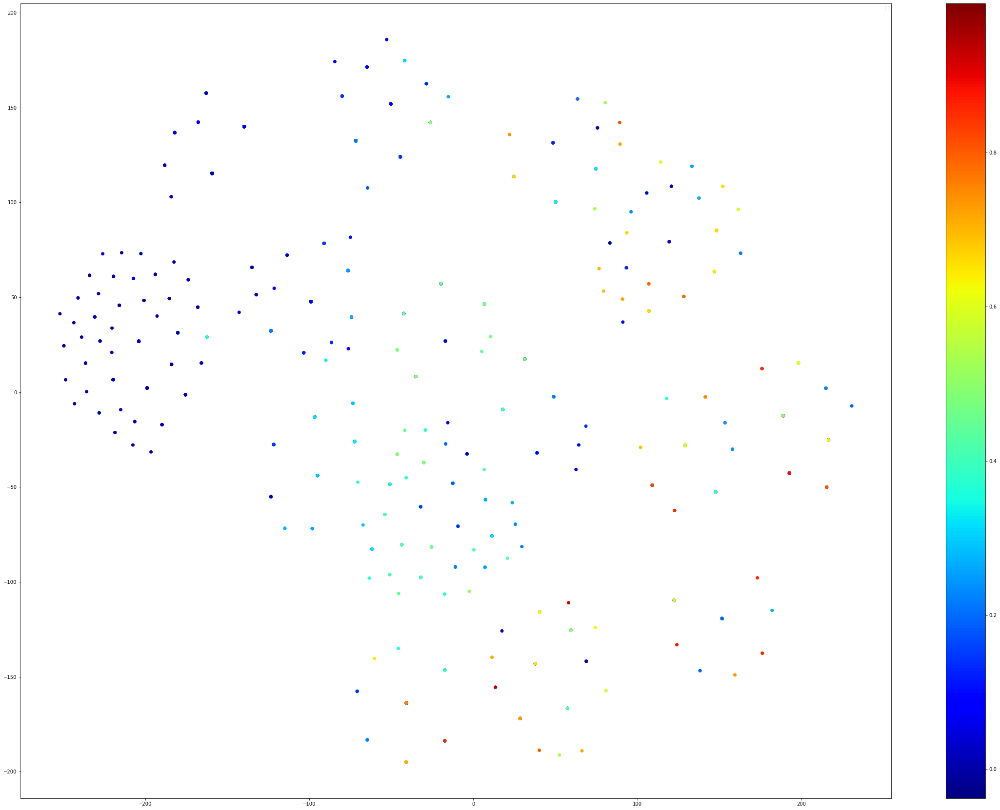

Perplexity =  696


No handles with labels found to put in legend.


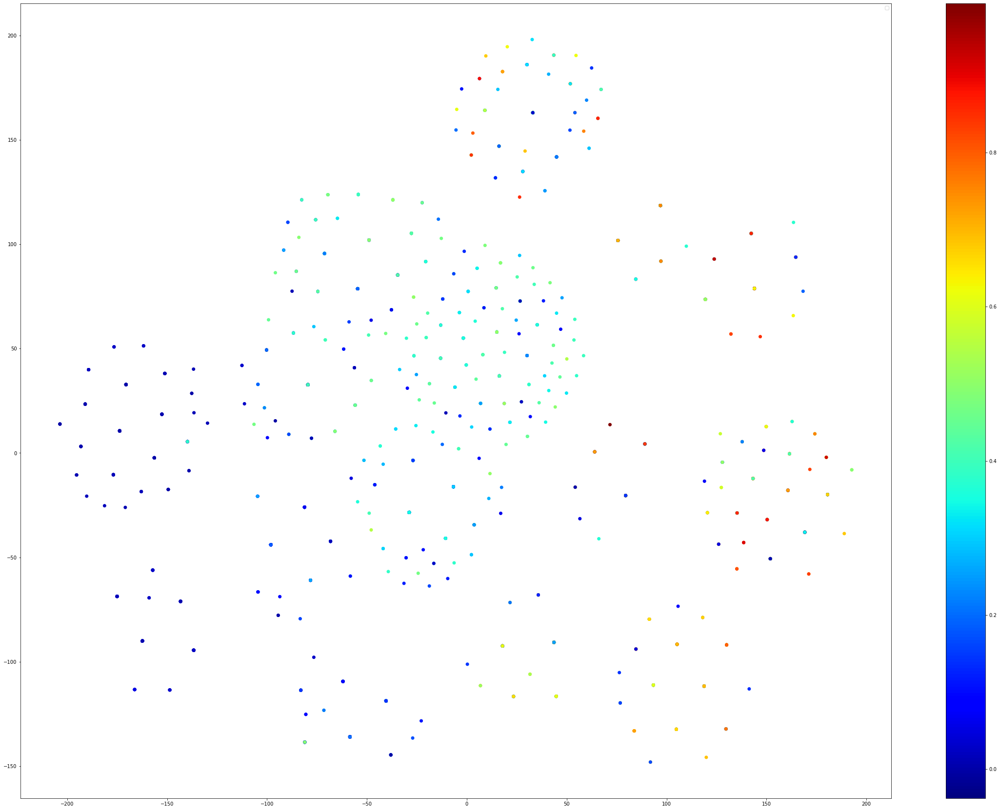

Perplexity =  717


No handles with labels found to put in legend.


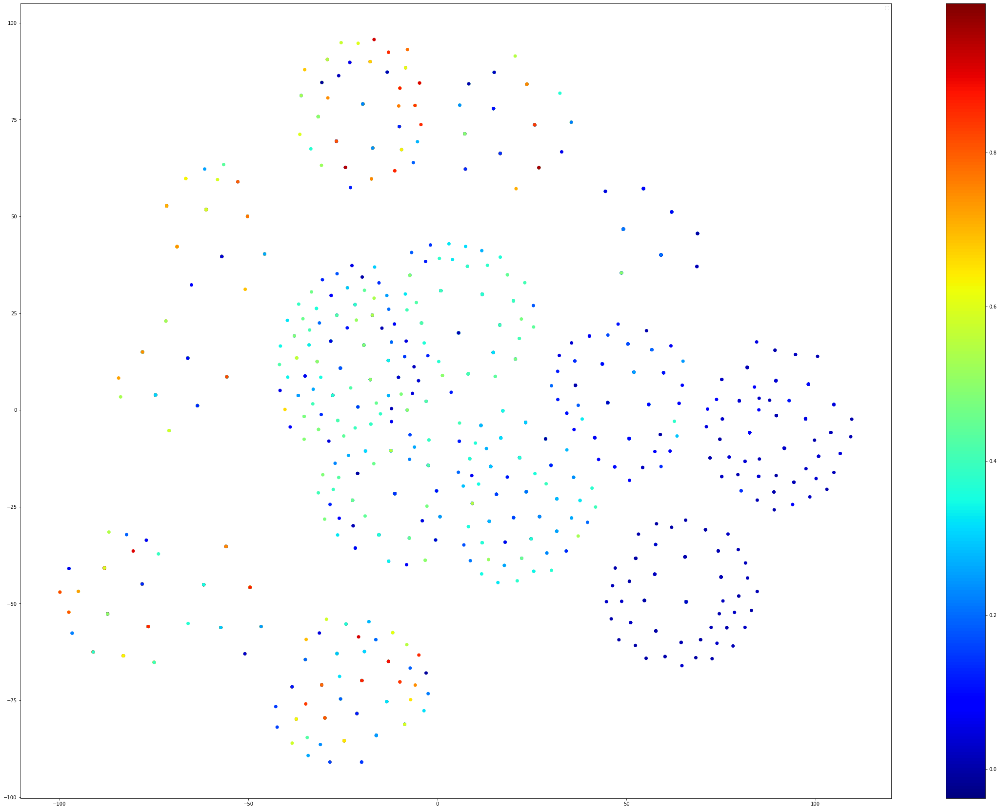

Perplexity =  737


No handles with labels found to put in legend.


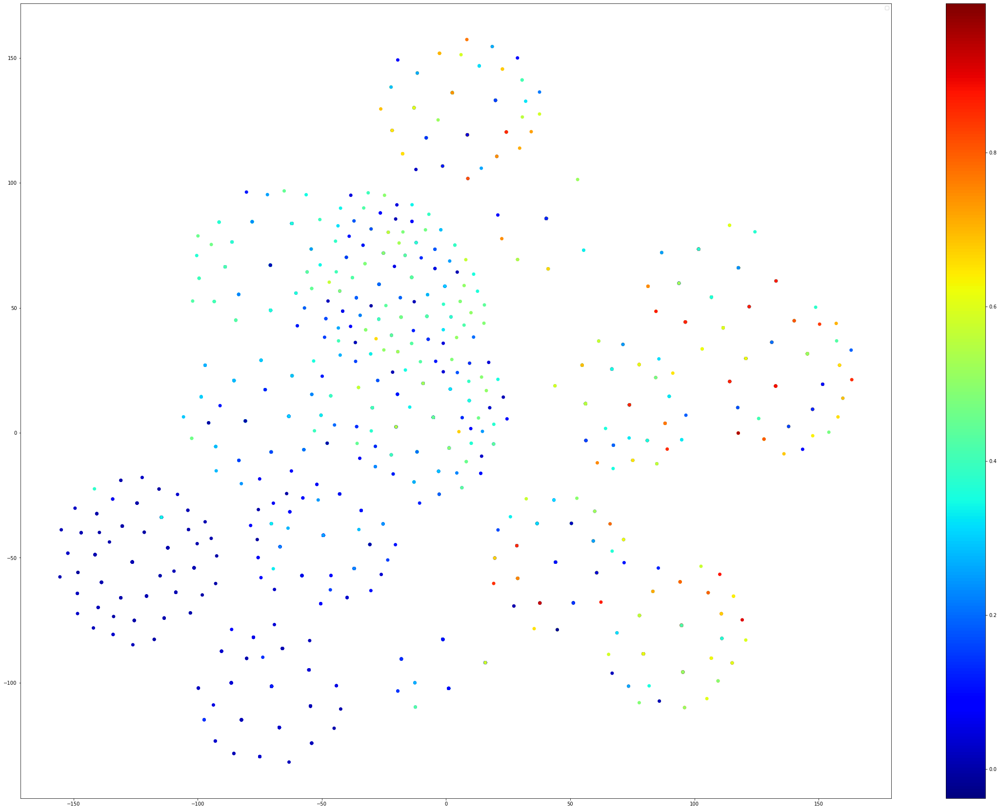

Perplexity =  757


No handles with labels found to put in legend.


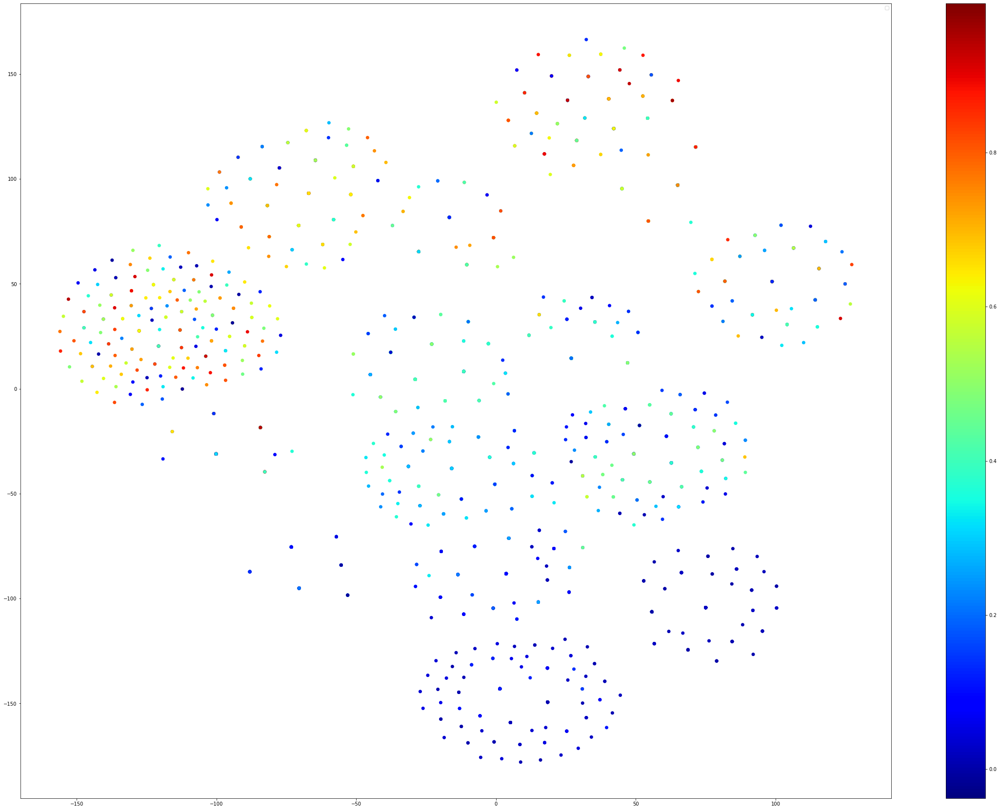

Perplexity =  777


No handles with labels found to put in legend.


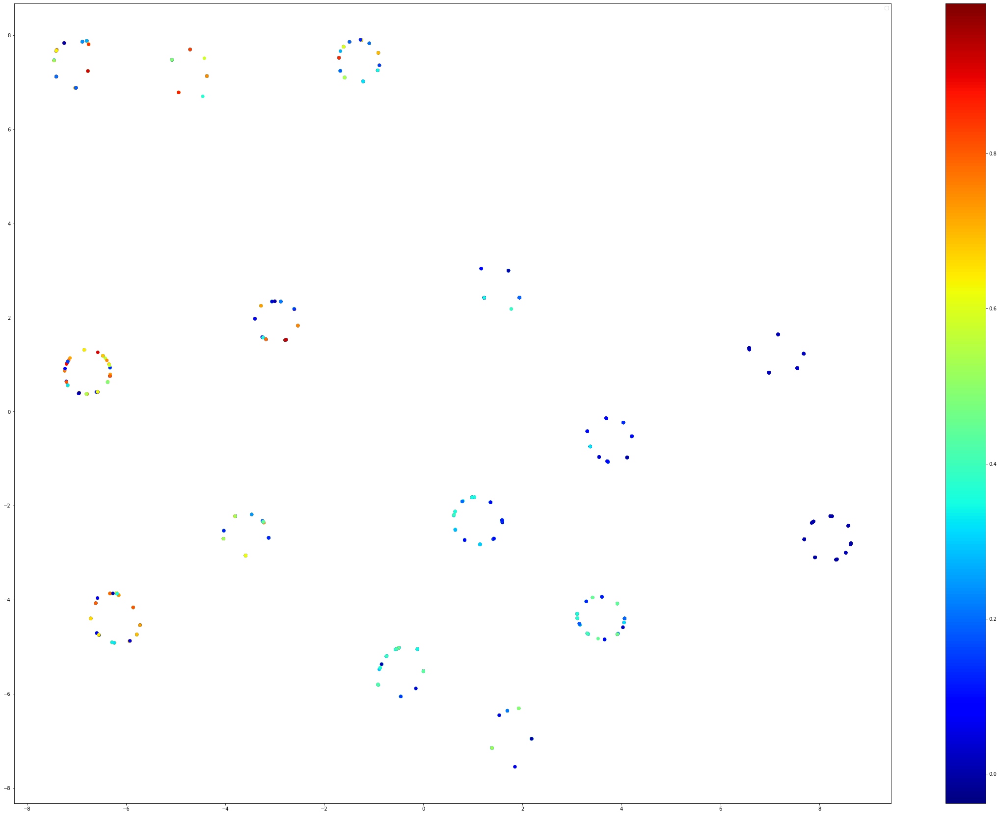

Perplexity =  797


No handles with labels found to put in legend.


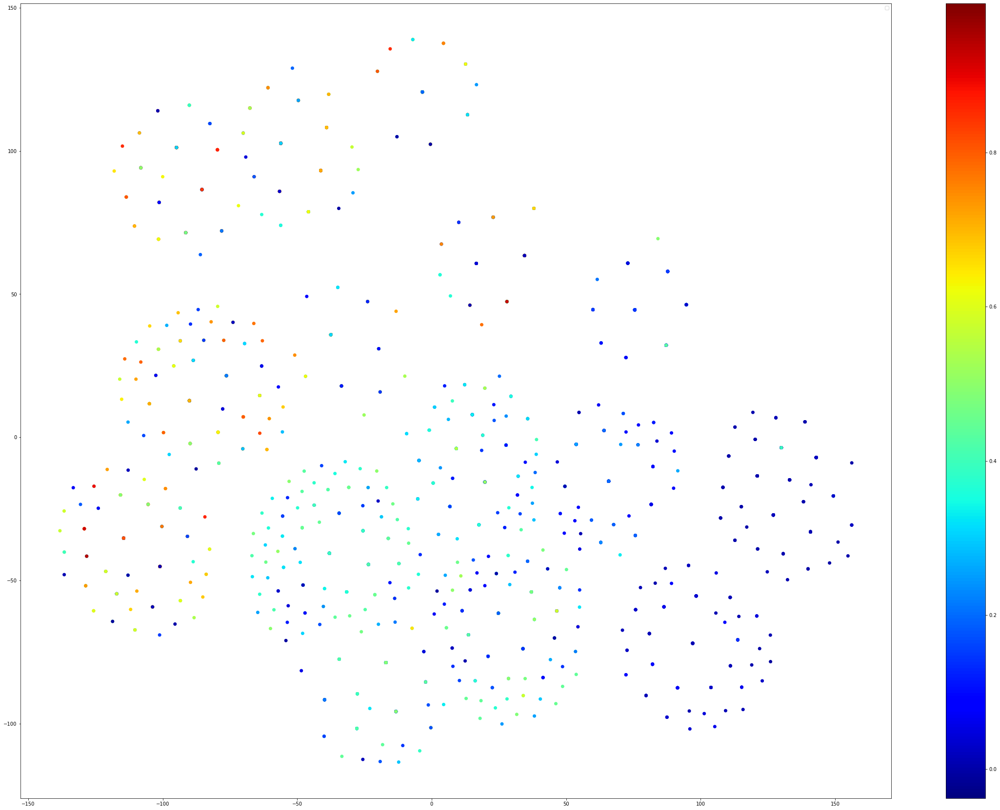

Perplexity =  818


No handles with labels found to put in legend.


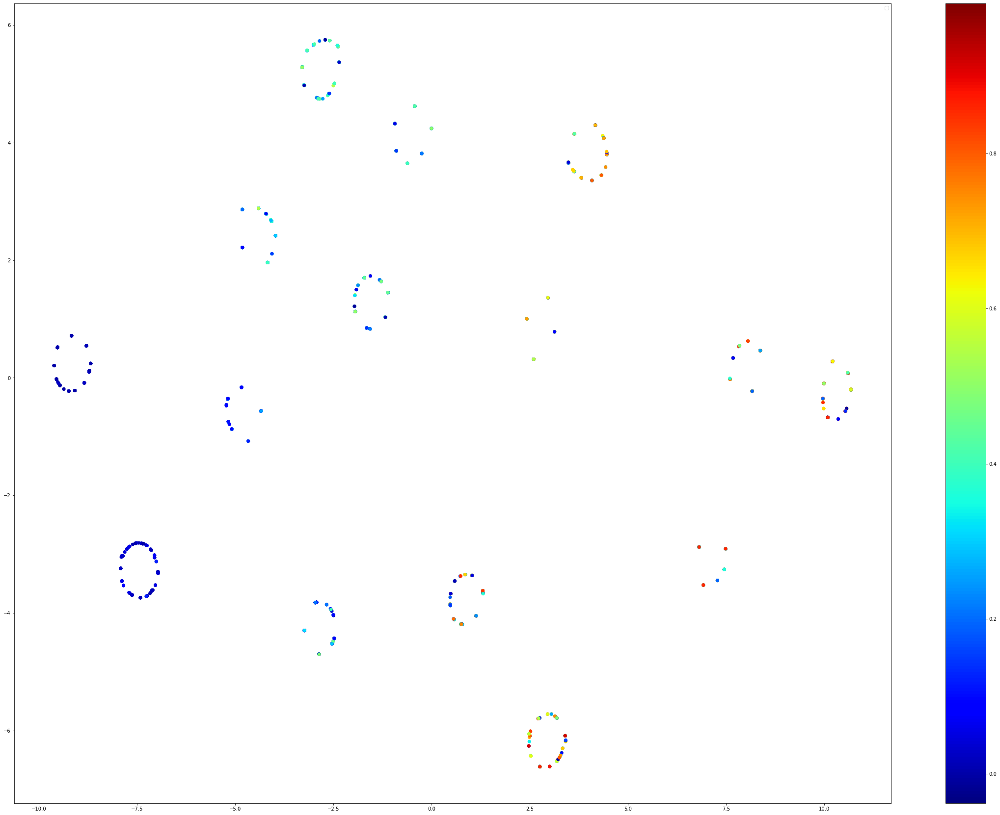

Perplexity =  838


No handles with labels found to put in legend.


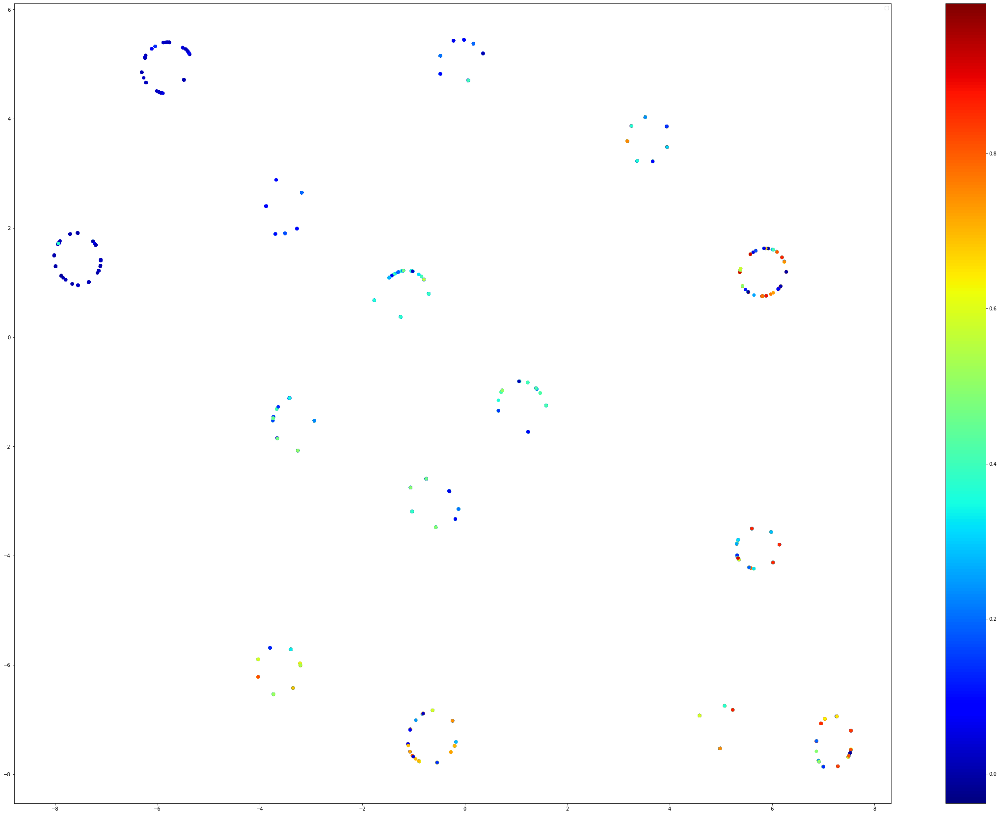

Perplexity =  858


No handles with labels found to put in legend.


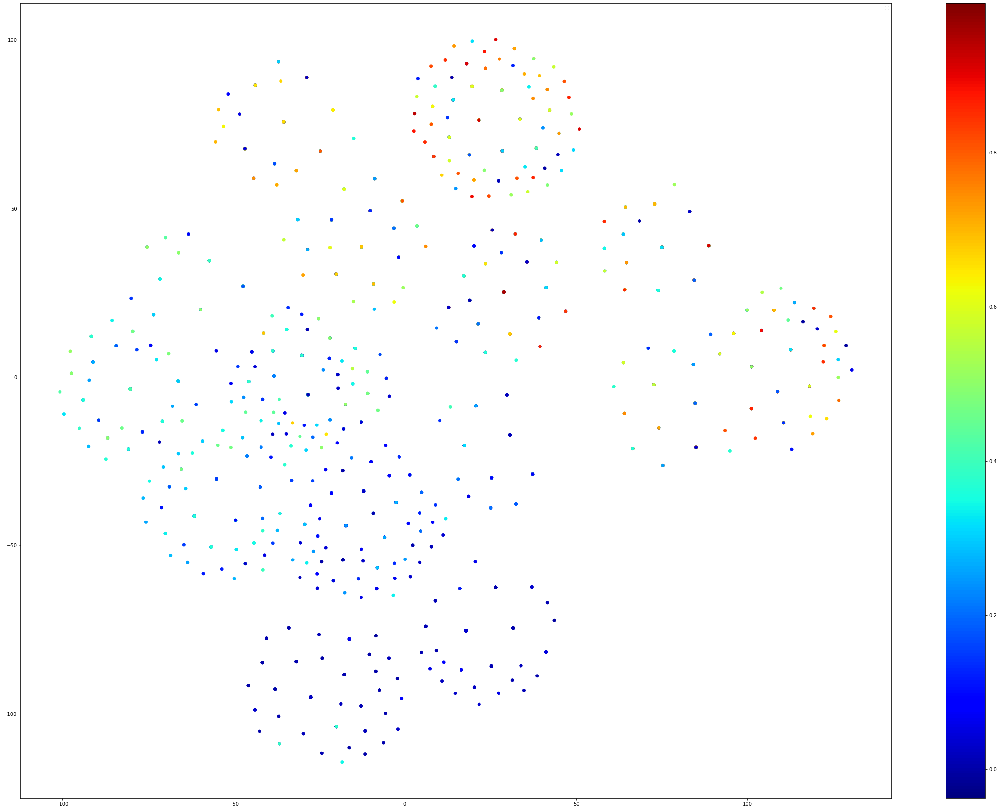

Perplexity =  878


No handles with labels found to put in legend.


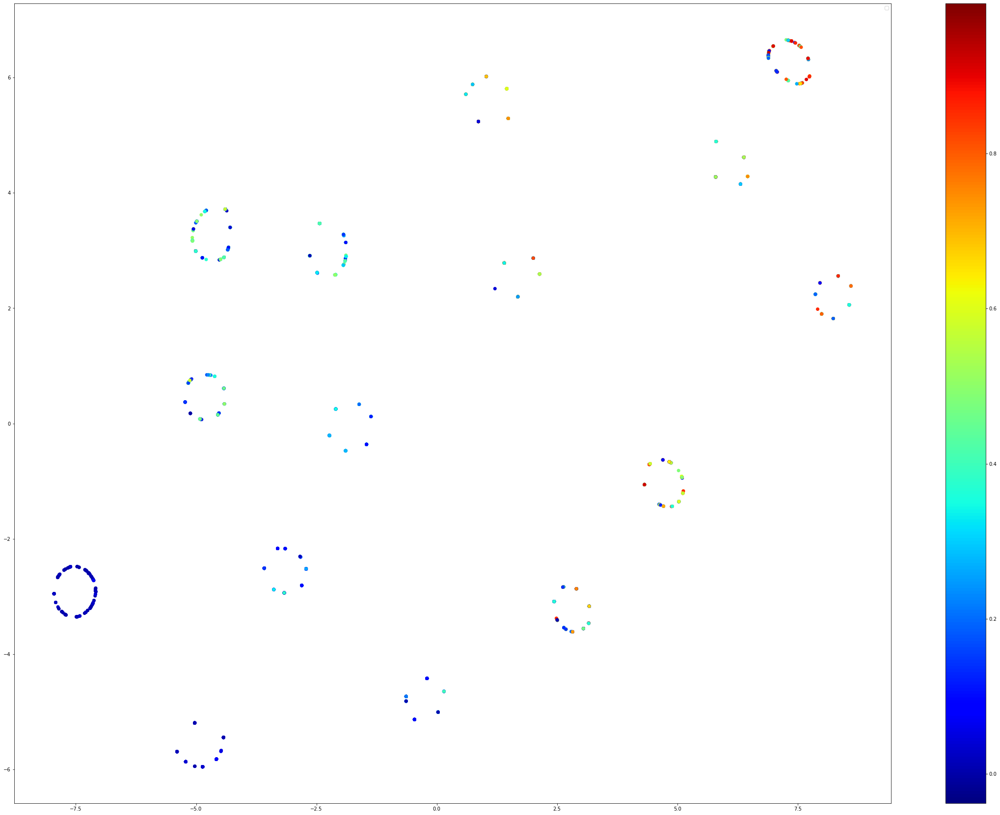

Perplexity =  898


No handles with labels found to put in legend.


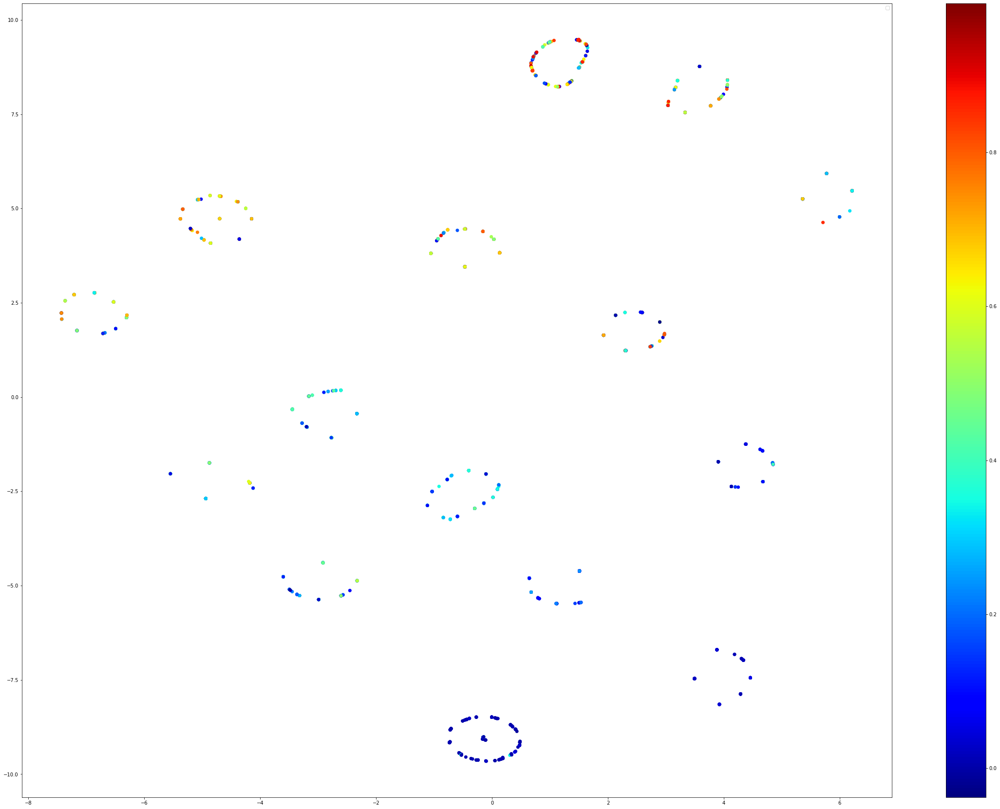

Perplexity =  919


No handles with labels found to put in legend.


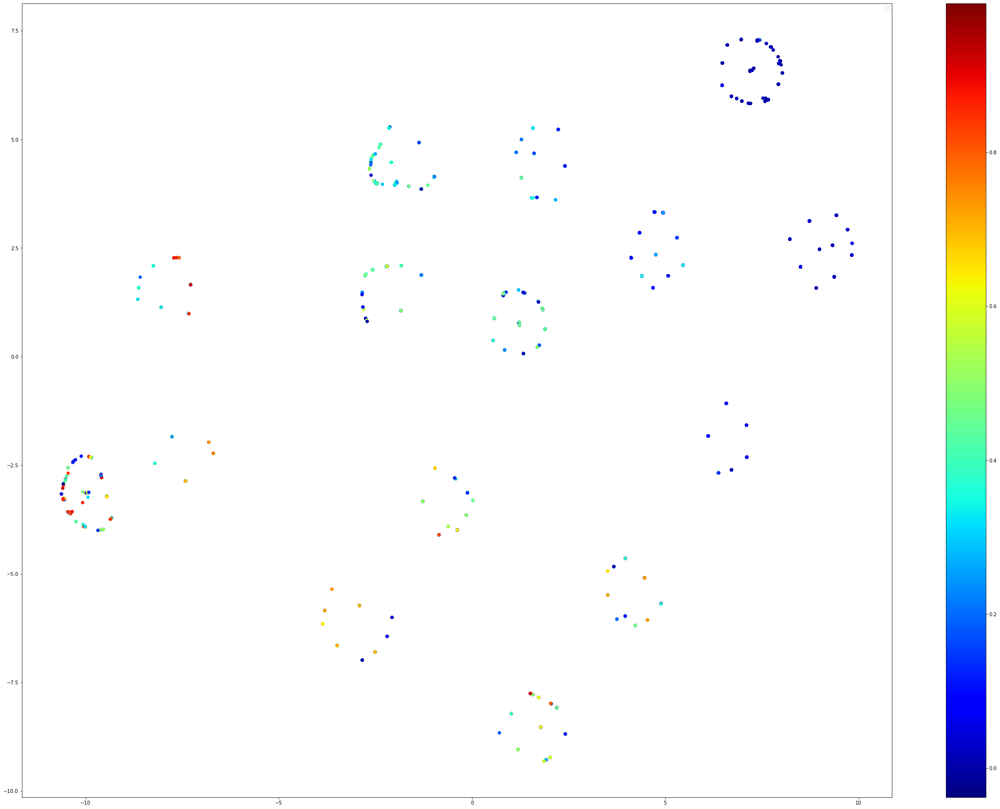

Perplexity =  939


No handles with labels found to put in legend.


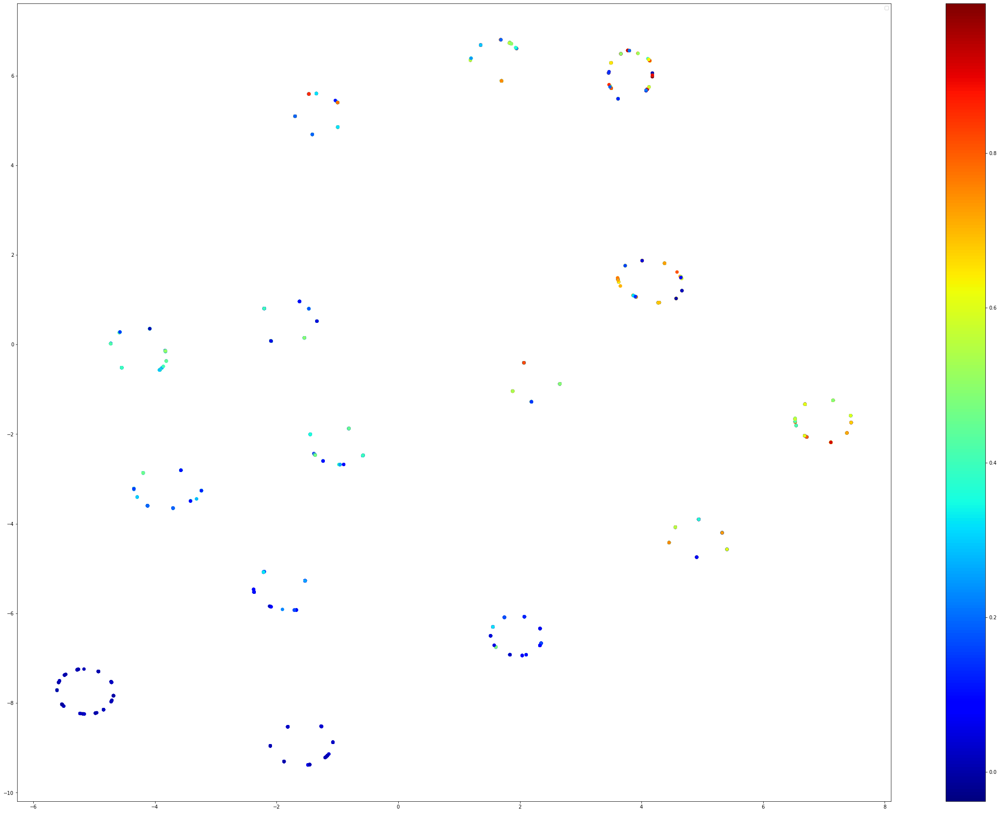

Perplexity =  959


No handles with labels found to put in legend.


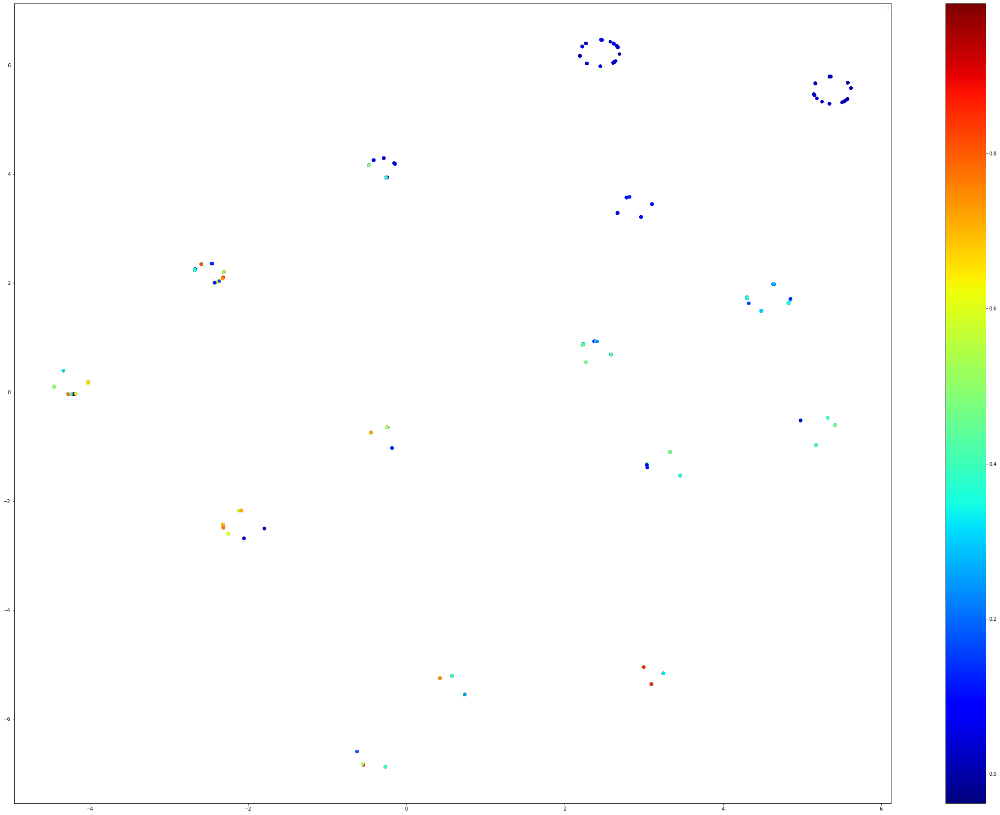

Perplexity =  979


No handles with labels found to put in legend.


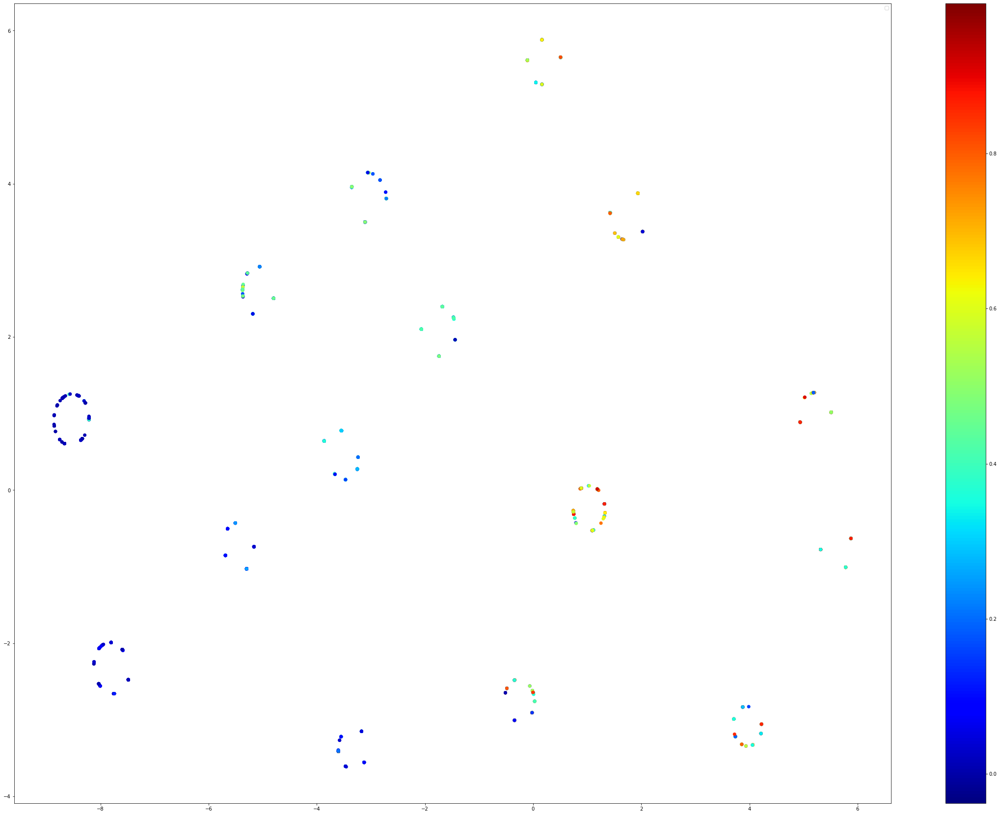

Perplexity =  1000


No handles with labels found to put in legend.


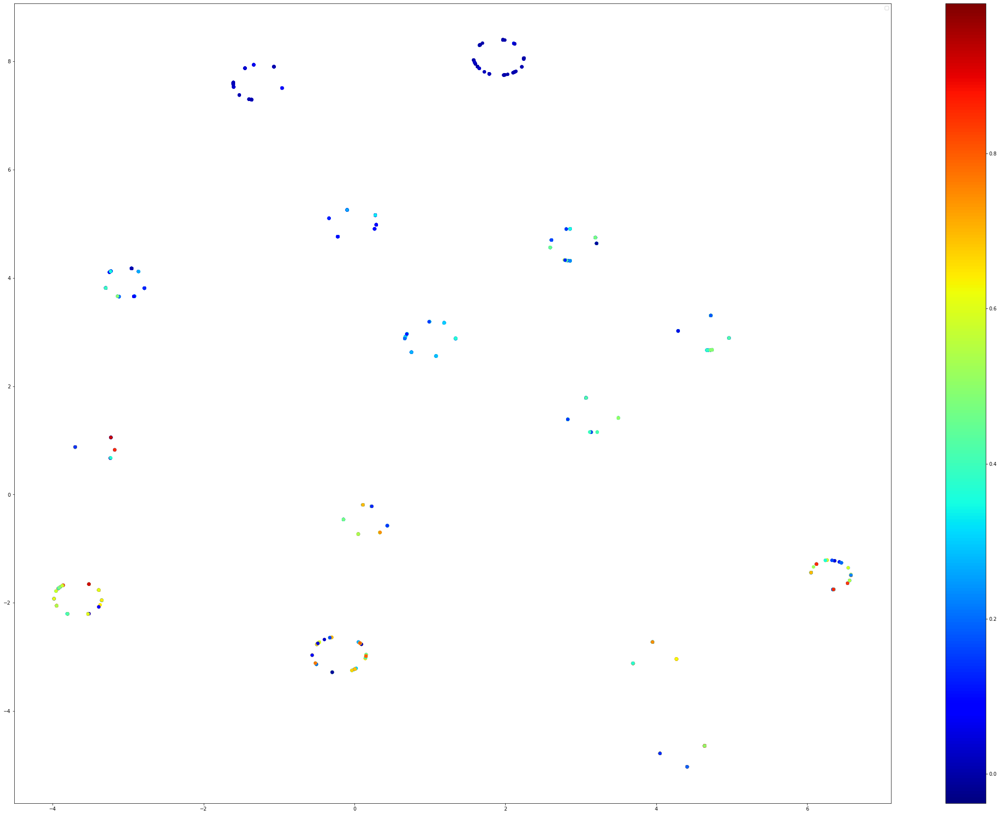

In [40]:
import numpy as np
for perplex in np.linspace(10, 1000, 50):
    perplex = int(perplex)
    print("Perplexity = ", perplex)
    hyperparams_tsne(perplexity = perplex)